<a href="https://colab.research.google.com/github/Yamile222768/Proyecto/blob/main/FINAL_Proyecto_ASE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


```
@file: Ingreso y educación
@brief: Proyecto Ase
@author: Yamile Márquez
@Date: 10/10/24
```





```
En el archivo de Google Colab se realizará el (ASE) para la asignatura de Ciencia de Datos.
Este proyecto integrará técnicas fundamentales de análisis de datos, limpieza,
visualización y modelado, aplicando conceptos clave para resolver un problema en
específico y extraer información valiosa de un conjunto de datos. A lo largo del código,
se utilizarán herramientas como Python, bibliotecas de manipulación de datos (Pandas,
NumPy) y de visualización (Matplotlib, Seaborn), con el objetivo de comprender mejor el
proceso de toma de decisiones basadas en datos y desarrollar habilidades prácticas en Ciencia de Datos.
```



NOTAS:

APRENDIZAJE Semi supervidado

# 0. Librerias/paquetes necesarios. La base de datos




In [ ]:
#Librerias
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.spatial.distance import cdist
from scipy.stats import f_oneway
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
#--------------------------------------------------
# --- Métricas de Evaluación ---
from sklearn.metrics import (
    accuracy_score,                        # Precisión global
    precision_score,                       # Precisión para clasificación binaria y multiclase
    recall_score,                          # Sensibilidad o recall (importante para detectar falsos negativos)
    f1_score,                              # F1 score (media armónica entre precisión y recall)
    silhouette_score,                      # Puntaje de Silhouette para evaluar la calidad de clusters
    adjusted_rand_score,                   # Índice de Rand Ajustado (ARI) para comparar clusters
    confusion_matrix,                      # Matriz de confusión
    ConfusionMatrixDisplay,                # Visualización de la matriz de confusión
    roc_curve,                             # Curva ROC para evaluación de modelos binarios
    roc_auc_score                          # Área bajo la curva ROC (AUC) como métrica de rendimiento binario
)
#from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier         # Clasificador Random Forest
from sklearn.linear_model import LogisticRegression         # Regresión logística para clasificación binaria o multiclase
from sklearn.svm import SVC                                 # Máquina de soporte vectorial (SVM) para clasificación
from sklearn.tree import DecisionTreeClassifier             # Árbol de decisión para clasificación
from sklearn.neighbors import KNeighborsClassifier          # Algoritmo de clasificación de K-vecinos más cercanos (KNN)
from sklearn.naive_bayes import GaussianNB
from sklearn.mixture import GaussianMixture
from sklearn.pipeline import Pipeline               # Clasificador Naive Bayes basado en distribución gaussiana
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
#Base de Datos
Base = 'Base de Datos Proyecto ASE.xlsx'




# 1. Convertir los archivo de dta a csv
```
La base de datos recuperada de Espinosa Yglesias, C. (2021).
se convierte de formato `.dta` a los formatos `.csv` y `.xlsx` para facilitar su manipulación y análisis.
```


In [ ]:
import pandas as pd

data = pd.read_stata('entrevistado.dta')
data.to_csv('entrevistado.csv')
data.to_excel('Base de Datos Proyecto ASE.xlsx')

FileNotFoundError: [Errno 2] No such file or directory: 'entrevistado.dta'


# 2. Reescribir las variables para que toda la base de datos este en enteros
```
  Se reescribio la base de datos 'Base de Datos Proyecto ASE.xlsx' en la hoja 'Entrevistado(3)', donde se encuentran los valores en caracteres. Posteriormente se realizo una hoja: 'Entrevistado (4)' con los datos en enteros.
```

In [ ]:
hoja3 = 'Entrevistado (3)'
df = pd.read_excel(Base, sheet_name=hoja3, header=1)

#________________________________________________________________
# Diccionario de reemplazo
reemplazos = {
    'Preescolar o kínder': 1,
    'Primaria': 2,
    'Secundaria técnica': 3,
    'Secundaria general': 4,
    'Preparatoria técnica': 5,
    'Preparatoria general': 6,
    'Técnica o comercial con secundaria': 7,
    'Técnica o comercial con preparatoria': 8,
    'Normal básica (con primaria o secundaria)': 9,
    'Normal de licenciatura': 10,
    'Profesional (licenciatura o ingeniería)': 11,
    'Postgrado (maestría o doctorado)': 12,
    'Ninguno/No fue a la escuela': 0,
    'Normal básica (con 2 o secundaria)': 9
}
df['nivel_alcanzado'] = df['nivel_alcanzado'].replace(reemplazos)
#________________________________________________________________
reemplazos_si_no = {
    'Sí': 1,
    'No': 2,
    'NS': 999,
    'No, nunca ha trabajado': 2,
    '999 998': 999
}
df = df.replace(reemplazos_si_no)
#________________________________________________________________
reemplazos_sexo = {
    'Hombre': 1,
    'Mujer': 2,
    'Otro': 3
}
df = df.replace(reemplazos_sexo)
#________________________________________________________________
reemplazo_actividad = {
    'Trabajó en una actividad con pago': 1,
    'Quehaceres del hogar': 6,
    'No trabajó pero sí tenía trabajo':3,
    'Trabajó en una actividad sin pago': 2,
    'Buscó trabajo (desempleado)':4,
    'Jubilado o pensionado':7,
    'Estudiante':5,
    'Incapacitado para trabajar de forma permanente':8
}
df ['actividad'] = df['actividad'].replace(reemplazo_actividad)
#________________________________________________________________
reemplazo_atencion_salud = {
    'Seguro Social (IMSS)': 1,
    'Consultorio de farmacias': 7,
    'Seguro Popular o INSABI': 4,
    'Centros de Salud (u hospitales de la SS)': 3,
    'Consultorio, clínica u hospital privado': 6,
    'Otro lugar': 9,
    'Otro servicio médico público': 5,
    'Se automedica': 8,
    'ISSSTE o ISSSTE Estatal': 2
}
df['atención_salud']= df['atención_salud'].replace(reemplazo_atencion_salud)
#_________________________________________________________________
reemplazo_afiliado = {
    'Seguro Social (IMSS)': 1,
    'No tiene derecho a servicios médicos': 7,
    'Seguro Popular o INSABI': 4,
    'ISSSTE o ISSSTE estatal': 2,
    'Seguro Privado': 5,
    'Otra institución': 6,
    'Pemex, Defensa o Marina': 3,
    'Ningún otro': 8
}
df['afiliado_1'] = df['afiliado_1'].replace(reemplazo_afiliado)
df['afiliado_2'] = df['afiliado_2'].replace(reemplazo_afiliado)
#_________________________________________________________________
reemplazo_tamaño_14 = {
    'Metrópoli (más de 500 mil habitantes)': 1,
    'Ciudad grande (entre 100 mil y 500 mil habitantes)': 2,
    'Ciudad chica (entre 2,500 y 15 mil habitantes)': 3,
    'Pueblo (menos de 2,500 habitantes)': 5,
    'Ciudad mediana (entre 15 mil y 100 mil habitantes)': 4
}
df['tamaño_14'] = df['tamaño_14'].replace(reemplazo_tamaño_14)
#_________________________________________________________________
reemplazo_sit_viv_14 = { #99
    'Propia': 3,
    'Prestada': 2,
    'Rentada': 1,
    'Otra situación': 5,
    'Intestada o en litigio': 4
}
df['sit_vivienda14'] = df['sit_vivienda14'].replace(reemplazo_sit_viv_14)
#_________________________________________________________________
reemplazo_provpension= {
    'Por su trabajo (IMSS o ISSSTE)': 1,
    'Esquema de jubilación privado': 3,
    'Pensión universal para adultos mayores': 5,
    'Divorcio o separación': 4,
    'Viudez (IMSS o ISSSTE)': 2,
}
df['Provpension_padre'] = df['Provpension_padre'].replace(reemplazo_provpension)
df['Provpension_madre'] = df['Provpension_madre'].replace(reemplazo_provpension)
#_________________________________________________________________
reemplazo_sosten = {
    'Su padre': 2,
    'Su madre': 3,
    'El propio entrevistado(a)': 4,
    'Su padre y su madre por igual': 1,
    'Otro pariente': 5,
    'Otro no pariente': 6
}
df['sosten_hogar'] = df['sosten_hogar'].replace(reemplazo_sosten)
#_________________________________________________________________
reemplazo_parentesco = {
    'Otro parentesco': 8,
    'Hermano': 7,
    'Sin parentesco': 9
}
df['p34Parentesco_OTRO'] = df['p34Parentesco_OTRO'].replace(reemplazo_parentesco)
#_________________________________________________________________
reemplazo_eduPadres = { #99
    'Primaria': 2,
    'Profesional (licenciatura o ingeniería)': 11,
    'Técnica o comercial con preparatoria': 8,
    'Preparatoria general': 6,
    'Secundaria general': 4,
    'Preparatoria técnica': 5,
    'Técnica o comercial con secundaria': 7,
    'Secundaria técnica': 3,
    'Normal de licenciatura': 10,
    'Postgrado (maestría o doctorado)': 12,
    'Normal básica (con primaria o secundaria)': 9,
    'Preescolar o kínder': 1
}
df['nivel_padre'] = df['nivel_padre'].replace(reemplazo_eduPadres)
df['nivel_madre'] = df['nivel_madre'].replace(reemplazo_eduPadres)
#_________________________________________________________________
reemplazo_sitPadre14 ={
    'Ya había fallecido': 9,
    'No trabajaba, pero sí trabajó': 2,
    'No, nunca trabajó': 3
}
df['sit_padre14'] = df['sit_padre14'].replace(reemplazo_sitPadre14)
#_________________________________________________________________
reemplazo_PadrePuesto = {
    'Jornalero(a) o peón': 3,
    'Empleado(a) u obrero(a) del sector privado': 1,
    'Trabajador(a) por cuenta propia': 5,
    'Patrón(a) o empleador(a)': 4,
    'Empleado(a) en el gobierno': 2,
    'Trabajador(a) sin pago': 6
}
df['padre_puesto'] = df['padre_puesto'].replace(reemplazo_PadrePuesto)
df['madre_puesto'] = df['madre_puesto'].replace(reemplazo_PadrePuesto)
df['sosten_puesto'] = df['sosten_puesto'].replace(reemplazo_PadrePuesto)
df['sit_ocupación'] = df['sit_ocupación'].replace(reemplazo_PadrePuesto)
df['1_puesto'] = df['1_puesto'].replace(reemplazo_PadrePuesto)
#_________________________________________________________________
reemplazo_padress = {
    'No estuvo afiliado o asegurado': 5,
    'IMSS': 1,
    'Otra institución de seguridad social': 3,
    'Una institución privada': 4,
    'ISSSTE': 2,
}
df['padre_ss'] = df['padre_ss'].replace(reemplazo_padress)
df['madre_ss'] = df['madre_ss'].replace(reemplazo_padress)
df['sosten_ss'] = df['sosten_ss'].replace(reemplazo_padress)
df['seg_social'] = df['seg_social'].replace(reemplazo_padress)
df['ss_1']= df['ss_1'].replace(reemplazo_padress)
#_________________________________________________________________
reemplazo_sitMadre = {
    'No trabajaba, pero sí trabajó': 6,
    'Nunca trabajó': 7,
    'Realizaba otra actividad a cambio de un pago': 5,
    'Trabajaba': 1,
    'Vendía algún producto': 3,
    'Ayudaba en labores del campo o en la cría de animales': 4,
    'Ayudaba en un negocio familiar o no familiar': 2,
    'Ya había fallecido': 9,
    'No, nunca trabajó': 7
 }
df['sit_madre'] = df['sit_madre'].replace(reemplazo_sitMadre)
#_________________________________________________________________
reemplazo_razonNoT = {
    'No tenía necesidad de trabajar': 8,
    'Tenía que dedicarse al cuidado del hogar': 9,
    'No tenía quién le cuidara a sus hijos pequeños': 5,
    'En localidad no había trabajo': 3,
    'No contaba con escolaridad/experiencia para realizar un trabajo': 1,
    'Tenía que cuidar a ancianos o enfermos': 6,
    'Estaba enferma': 4,
    'No la dejaba un familiar': 7,
    'Otras razones': 10,
    'Por su edad/aspecto no la aceptarían en un trabajo': 2,
 }
df['madre_razón_no_trab'] = df['madre_razón_no_trab'].replace(reemplazo_razonNoT)
#_________________________________________________________________
reemplazo_sitSosten = {
    'No, nunca trabajó': 3,
    'No trabajaba, pero sí trabajó': 2
}
df['sit_sosten'] = df['sit_sosten'].replace(reemplazo_sitSosten)
#_________________________________________________________________
reemplazo_eduPubPriv = {
    'Pública': 1,
    'Privada': 2
}
df['primaria_pubPriv'] = df['primaria_pubPriv'].replace(reemplazo_eduPubPriv)
df['sec_pubPriv'] = df['sec_pubPriv'].replace(reemplazo_eduPubPriv)
df['prepa_pubPriv'] = df['prepa_pubPriv'].replace(reemplazo_eduPubPriv)
df['univ_pubPriv'] = df['univ_pubPriv'].replace(reemplazo_eduPubPriv)
#_________________________________________________________________
remplazo_eduTurno = {
    'Matutino': 1,
    'Vespertino': 2
}
df['primaria_turno'] = df['primaria_turno'].replace(remplazo_eduTurno)
df['sec_turno'] = df['sec_turno'].replace(remplazo_eduTurno)
#_________________________________________________________________
reemplazo_sitLaboral = {
    'Trabajó al menos una hora': 1,
    'No trabajó': 5,
    'Dedicó al menos una hora a vender algún producto': 3,
    'Realizó otro tipo de actividad a cambio de un pago': 4,
    'Ayudó en un negocio familiar o de otra persona': 2
}
df['sit_laboral'] = df['sit_laboral'].replace(reemplazo_sitLaboral)
#_________________________________________________________________
reemplazo_razonNoTrabajo = {
    'No tiene quién le cuide a sus hijos pequeños': 8,
    'Espera respuesta a una solicitud': 1,
    'Por su edad o por su aspecto no lo aceptarían en un trabajo': 4,
    'Otras razones personales': 14,
    'No tiene necesidad de trabajar': 11,
    'No tiene deseos de trabajar': 12,
    'No hay trabajo o solo se realiza en ciertas temporadas del año': 5,
    'No lo(a) deja un familiar': 10,
    'Tiene que cuidar ancianos, enfermos o personas con discapacidad': 9,
    'Espera recuperarse de una enfermedad o accidente': 6,
    'No hay trabajo en su especialidad, oficio o profesión': 2,
    'Está embarazada': 7,
    'Otras razones de mercado': 13,
    'No cuenta con escolaridad, papeles o experiencia': 3
 }
df['razon_no_trab'] = df['razon_no_trab'].replace(reemplazo_razonNoTrabajo)
#_________________________________________________________________
reemplazo_tipoContrato = {
    'Base, planta o por tiempo indeterminado': 2,
    'Temporal o por obra determinada': 1,
    'Por periodo de prueba': 4,
    'Hasta el término de la obra': 5,
    'Capacitación inicial': 3,
}
df['tipo_contrato'] = df['tipo_contrato'].replace(reemplazo_tipoContrato)
df['tipo_contrato_1'] = df['tipo_contrato_1'].replace(reemplazo_tipoContrato)
#_________________________________________________________________
reemplazo_sitViv = {
    'Propia': 3,
    'Prestada': 2,
    'Rentada': 1,
    'Otra situación': 6,
    'Intestada o en litigio': 5,
    'Propia, pero la sigue pagando': 4
}
df['sit_vivienda'] = df['sit_vivienda'].replace(reemplazo_sitViv)
#_________________________________________________________________
reemplazo_propViv = {
    'Otra persona que reside en la vivienda': 4,
    'Entrevistado(a)': 1,
    'El cónyuge': 2,
    'El entrevistado(a) y el cónyuge': 3
}
df['prop_vivienda'] = df['prop_vivienda'].replace(reemplazo_propViv)
#_________________________________________________________________
reemplazo_parentProp ={
    'Padre o madre': 4,
    'Hijo(a)': 3,
    'Suegro (a)': 5,
    'Hermano (a)': 7,
    'Otro parentesco': 8,
    'Sin parentesco': 9,
    'Yerno o nuera': 6,
}
df['parent_prop'] = df['parent_prop'].replace(reemplazo_parentProp)
#_________________________________________________________________
reemplazo_salMin = {
    'Más de 2 salarios mínimos hasta 3 ($8,503 – $12,753)': 4,
    'Menor a 1 salario mínimo ($0 – $4,250)': 1,
    'Más de 1 salario mínimo hasta 2 ($4,252 – $8,502)': 3,
    'Igual a un salario mínimo ($4,251)': 2,
    'No quiso dar información': 8,
    'Más de 3 salarios mínimos hasta 5 ($12,574 – $21,255)': 5,
    'Más de 5 salarios mínimos hasta 10 ($21,255 – $42,510)': 6,
    'Más de 10 salarios mínimos ($42,511 o más)': 7,
}
df['ingreso_salMin'] = df['ingreso_salMin'].replace(reemplazo_salMin)
#_________________________________________________________________
# Guardar los cambios en un nuevo archivo Excel
output_Base = 'archivo_modificado.xlsx'
df.to_excel(output_Base, sheet_name=hoja3, index=False)
print(f'Archivo modificado guardado como {output_Base}')


<ipython-input-3-c2d5ec3761eb>:22: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['nivel_alcanzado'] = df['nivel_alcanzado'].replace(reemplazos)
<ipython-input-3-c2d5ec3761eb>:31: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.replace(reemplazos_si_no)
<ipython-input-3-c2d5ec3761eb>:38: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('f

Archivo modificado guardado como archivo_modificado.xlsx


In [ ]:
df.shape

(3767, 154)

In [ ]:
df.head()

,rur_urb,total_hogar,edad_cumplida,sexo,asiste_escuela,nivel_alcanzado,año_alcanzado,actividad,atención_salud,afiliado_1,...,seg_colonia,facil_transp,limpieza_calles,num_autos,miembros_ingreso,ingreso_total,ingreso_salMin,hogar_ubicacion,hogar_ubicacion14,lengua_indigena
0,1,4,30,1,2.0,6,3.0,1,1,1,...,1,1,1,0.0,1.0,999999.0,NaN,5,3,2
1,1,3,39,2,2.0,3,3.0,1,1,1,...,1,1,1,1.0,2.0,999998.0,4.0,5,5,2
2,1,7,36,1,2.0,2,4.0,1,7,1,...,1,1,1,0.0,2.0,6000.0,NaN,5,5,2
3,1,5,39,2,2.0,4,3.0,6,7,7,...,2,1,2,0.0,2.0,999998.0,4.0,4,4,2
4,1,5,31,2,2.0,4,3.0,6,7,7,...,2,2,2,0.0,1.0,999999.0,NaN,5,3,2





# 3. Limpieza de base de Datos MANUAL
```
Comenzamos con 154 columnas
En un primer momento se realiza una limpieza manual de la base de datos.
El objetivo es diminuir el número de columnas.

a. Nos enfocaremos en eliminar valores nulos.
```

In [ ]:
# Reemplazar los espacios vacíos con NaN
hoja4 = 'Entrevistado (4)'
dff = pd.read_excel(Base, sheet_name=hoja4, header=1)

dff.replace('', np.nan, inplace=True)
dff.replace(r'^\s*$', np.nan, regex=True, inplace=True)
dff.to_excel('archivo_modificado2.xlsx', index=False)

In [ ]:
# Contar valores NA en cada columna
na_por_columna = dff.isna().sum()

# Mostrar todas las filas sin truncar para evaluar cual eliminar
pd.set_option('display.max_rows', None)

# Mostrar los resultados
#print(na_por_columna)

*El porcentaje para decidir eliminar una columna puede depender del contexto y del tipo de análisis que se esté realizando. Sin embargo, un umbral comúnmente utilizado en muchos análisis de datos es el 70% de valores faltantes.*

1. **Pérdida significativa de información**
2. **Impacto en el modelo**:
3. **Coste-beneficio de imputación**


In [ ]:
# Convertir los valores NA a porcentaje
total_filas = dff.shape[0]
total_columnas = dff.shape[1]
na_porcentaje = (na_por_columna / total_filas) * 100

# Configurar pandas para mostrar todas las filas sin truncar
pd.set_option('display.max_rows', None)

# Mostrar los resultados en porcentaje
#print(na_porcentaje)

Una vez que eliminamos las columnas con un gran porcentaje de NaN, vemos como se encuentran las filas

In [ ]:
# Contar cuántos valores NA hay por fila
na_por_fila = dff.isna().sum(axis=1)

# Mostrar solo las primeras 1000 filas con el conteo de NA
primeras_1000_filas = na_por_fila.head(1000)

# Configurar pandas para mostrar todas las filas sin truncar (si aplica)
pd.set_option('display.max_rows', None)

# Mostrar los resultados
#print(primeras_1000_filas)

dff.head()

,rur_urb,total_hogar,edad_cumplida,sexo,asiste_escuela,nivel_alcanzado,año_alcanzado,actividad,atención_salud,afiliado_1,...,seg_colonia,facil_transp,limpieza_calles,num_autos,miembros_ingreso,ingreso_total,ingreso_salMin,hogar_ubicacion,hogar_ubicacion14,lengua_indigena
0,1,4,30,1,2.0,6,3.0,1,1,1,...,1,1,1,0.0,1.0,0.1,NaN,5,3,2
1,1,3,39,2,2.0,3,3.0,1,1,1,...,1,1,1,1.0,2.0,0.2,4.0,5,5,2
2,1,7,36,1,2.0,2,4.0,1,7,1,...,1,1,1,0.0,2.0,6000.0,NaN,5,5,2
3,1,5,39,2,2.0,4,3.0,6,7,7,...,2,1,2,0.0,2.0,0.2,4.0,4,4,2
4,1,5,31,2,2.0,4,3.0,6,7,7,...,2,2,2,0.0,1.0,0.1,NaN,5,3,2


In [ ]:
# Contar cuántos valores NA hay por fila
na_por_fila = dff.isna().sum(axis=1)

# Filtrar solo las filas que tienen más de 50 valores faltantes
filas_mas_de_50_na = na_por_fila[na_por_fila > 40]

# Configurar pandas para mostrar todas las filas sin truncar (si aplica)
pd.set_option('display.max_rows', None)

# Mostrar los resultados
#print(filas_mas_de_50_na)


In [ ]:
#Cargamos la hoja con los datos hechos guardados
hoja5 = 'Entrevistado (6)'
df1 = pd.read_excel(Base, sheet_name=hoja5, header=1)

# Rellenar valores NaN con la media de cada columna numérica en todo el DataFrame
#df1 = df1.apply(lambda col: col.fillna(col.mean()) if pd.api.types.is_numeric_dtype(col) else col)



```
Visualización de los 129 datos y los 92 datos





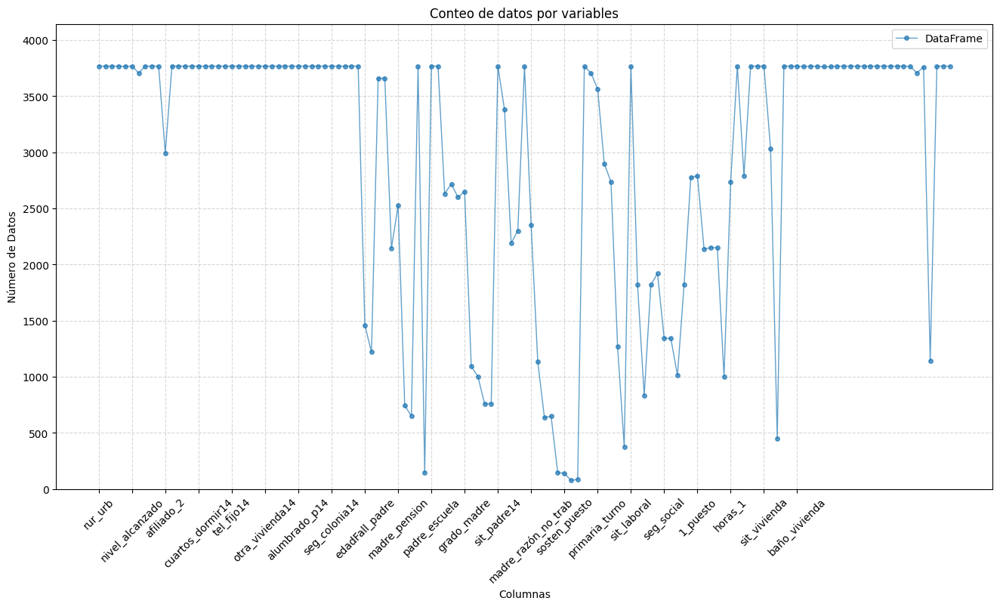

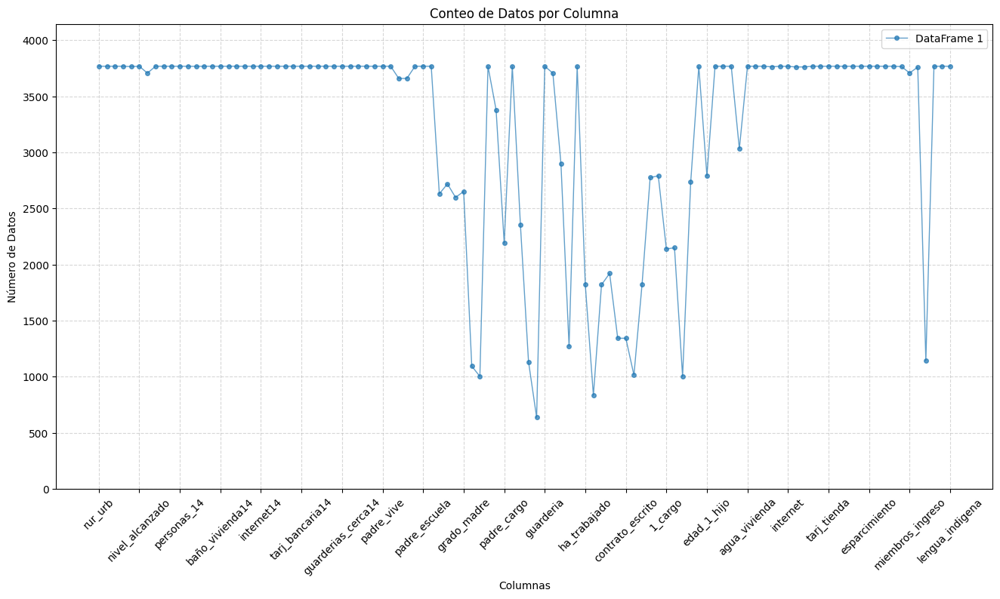

In [ ]:
# Supongamos que tus DataFrames se llaman df1 y df2
conteo_datos_df = dff.count()
conteo_datos_df1 = df1.count()

# Determinar el mismo límite máximo para el eje Y en ambos gráficos
y_max = max(conteo_datos_df.max(), conteo_datos_df1.max())*1.1

# Gráfico para el primer DataFrame
plt.figure(figsize=(16, 8))
plt.plot(conteo_datos_df, marker='o', linestyle='-', linewidth=1, markersize=4, alpha=0.7, label='DataFrame')
plt.ylim(0, y_max)  # Establecer el mismo límite en el eje Y
plt.xlabel("Columnas")
plt.ylabel("Número de Datos")
plt.title("Conteo de datos por variables")
plt.xticks(range(0, len(conteo_datos_df1), max(1, len(conteo_datos_df1) // 20)), rotation=45)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.show()

# Gráfico para el segundo DataFrame
plt.figure(figsize=(16, 8))
plt.plot(conteo_datos_df1, marker='o', linestyle='-', linewidth=1, markersize=4, alpha=0.7, label='DataFrame 1')
plt.ylim(0, y_max)  # Establecer el mismo límite en el eje Y
plt.xlabel("Columnas")
plt.ylabel("Número de Datos")
plt.title("Conteo de Datos por Columna")
plt.xticks(range(0, len(conteo_datos_df1), max(1, len(conteo_datos_df1) // 20)), rotation=45)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.show()



```
Una vez que se termino de hacer la limpieza de datos de forma manual. Nos quedamos con 106 columnas. Esto nos da una perspectiva de por donde aproximadamente podriamos reducir el número de variables.
Sin embargo, la manera de abordar los datos puede optimizarse.
```



# 4. Analisis Exploratorio


```
Comenzamos con  106 columnas
```





## a. Analisis de correlacion




In [ ]:
df1.shape

(3767, 106)

In [ ]:
corr_matrix = df1.corr()

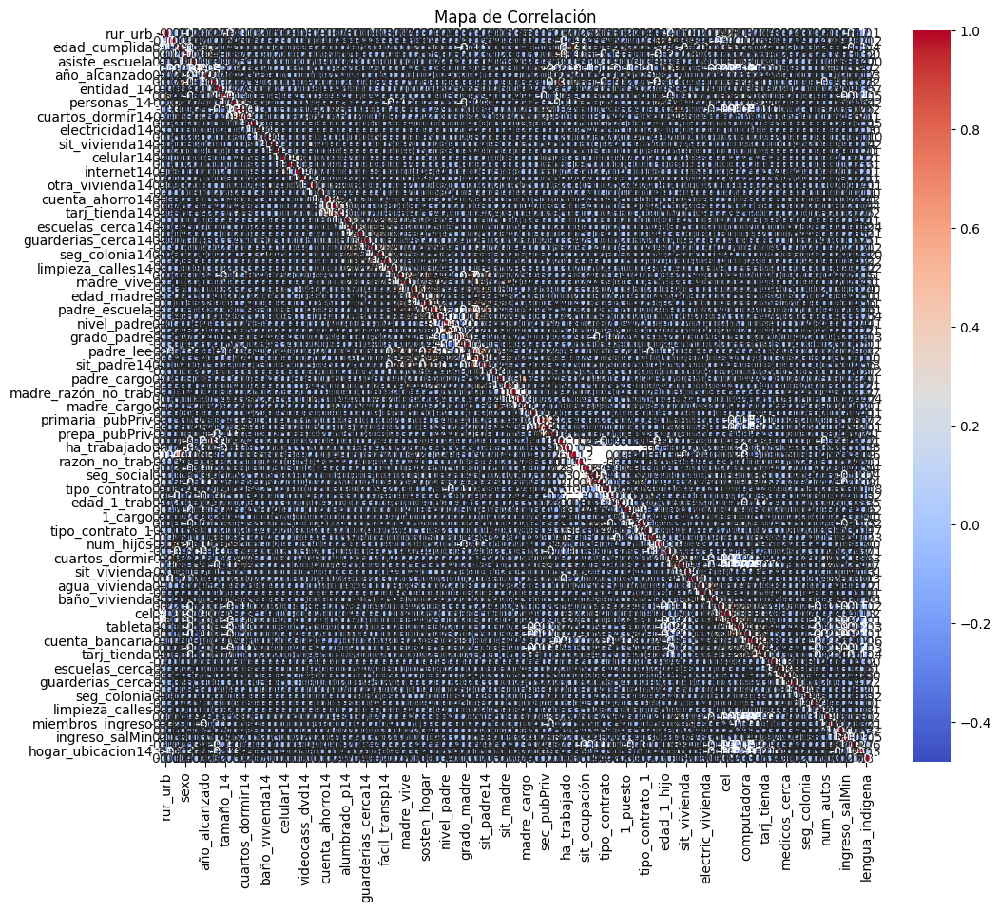

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Mapa de Correlación')
plt.show()

No alcanzamos a distinguir las correlaciones. Hacemos  un ajuste al mapa

In [ ]:
cm = sns.light_palette("green", as_cmap=True)
styled_corr_matrix = corr_matrix.style.background_gradient(cmap=cm)
styled_corr_matrix

**Valores positivos indican una correlación positiva:** *cuando una variable aumenta, la otra también tiende a aumentar.*

**Valores negativos indican una correlación negativa:** *cuando una variable aumenta, la otra tiende a disminuir.*

**Valores cercanos a 0** *sugieren que no hay una correlación lineal significativa entre las variables.*

**La diagonal principal ***(de arriba a la izquierda a abajo a la derecha) muestra el valor 1.0 para cada variable consigo misma (autocorrelación), lo cual es esperado.*




```
Veremos las correlaciónes con mayor y menor importancia
```



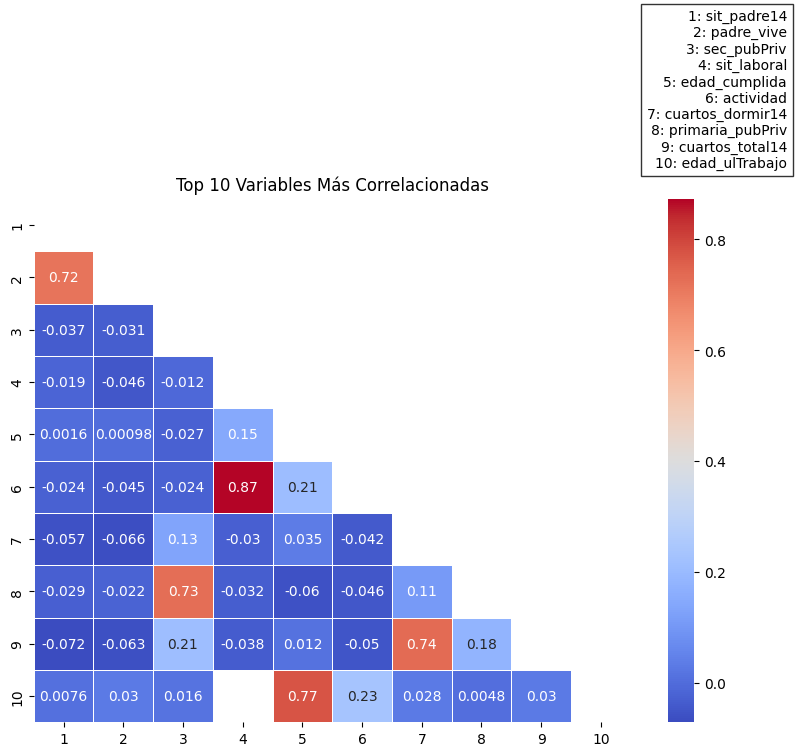

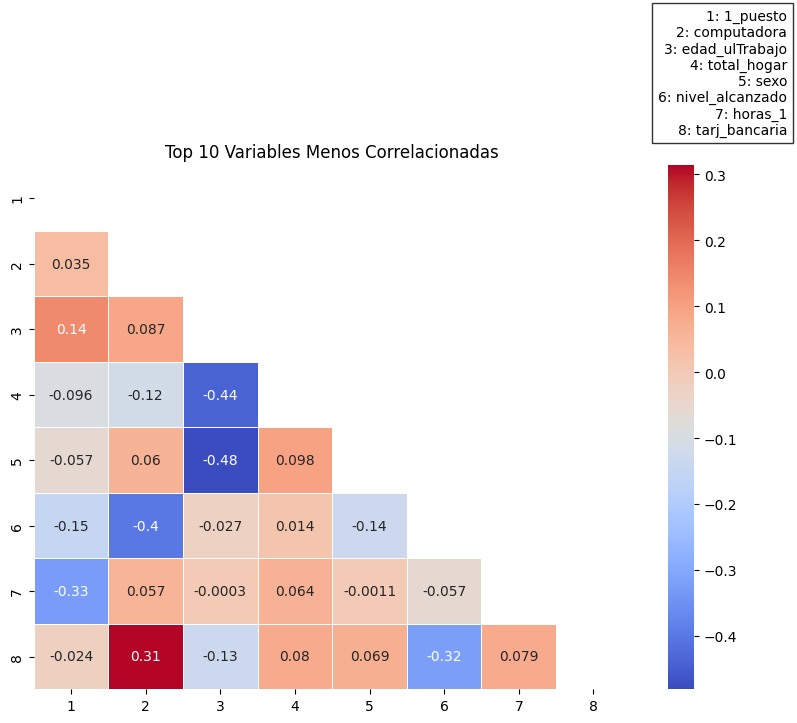

In [ ]:
# Ordenar la matriz de correlación para obtener las 10 mayores y menores correlaciones
corr_matrix = corr_matrix.unstack().sort_values(ascending=False)

# Filtrar las correlaciones que no son entre la misma variable (evitar la diagonal)
corr_matrix = corr_matrix[corr_matrix < 1]

# Obtener las 10 mayores correlaciones (top correlaciones)
top_10 = corr_matrix.head(10)

# Obtener las 10 menores correlaciones (bottom correlaciones)
bottom_10 = corr_matrix.tail(10)

# Obtener las variables más y menos correlacionadas
top_variables = list(set(top_10.index.get_level_values(0).append(top_10.index.get_level_values(1))))
bottom_variables = list(set(bottom_10.index.get_level_values(0).append(bottom_10.index.get_level_values(1))))

# Crear las submatrices de correlación para las variables seleccionadas
top_corr_matrix = df1[top_variables].corr()
bottom_corr_matrix = df1[bottom_variables].corr()

# Crear un mapeo de los nombres de las variables a números
top_variable_map = {name: str(i+1) for i, name in enumerate(top_variables)}
bottom_variable_map = {name: str(i+1) for i, name in enumerate(bottom_variables)}

# Reemplazar los nombres de las variables en las matrices de correlación por números
top_corr_matrix = top_corr_matrix.rename(columns=top_variable_map, index=top_variable_map)
bottom_corr_matrix = bottom_corr_matrix.rename(columns=bottom_variable_map, index=bottom_variable_map)

# Crear las máscaras para las matrices triangulares
mask_top = np.triu(np.ones_like(top_corr_matrix, dtype=bool))
mask_bottom = np.triu(np.ones_like(bottom_corr_matrix, dtype=bool))

# Graficar el heatmap triangular para las 10 variables más correlacionadas
plt.figure(figsize=(8, 6))
sns.heatmap(top_corr_matrix, annot=True, cmap='coolwarm', mask=mask_top, linewidths=0.5)
plt.title('Top 10 Variables Más Correlacionadas')

# Crear leyenda con los números y los nombres de las variables
plt.figtext(0.99, 0.99, '\n'.join([f"{i+1}: {name}" for i, name in enumerate(top_variables)]),
            horizontalalignment='right', fontsize=10, bbox=dict(facecolor='white', alpha=0.8))
plt.tight_layout()
plt.show()

# Graficar el heatmap triangular para las 10 variables menos correlacionadas
plt.figure(figsize=(8, 6))
sns.heatmap(bottom_corr_matrix, annot=True, cmap='coolwarm', mask=mask_bottom, linewidths=0.5)
plt.title('Top 10 Variables Menos Correlacionadas')

# Crear leyenda con los números y los nombres de las variables
plt.figtext(0.99, 0.99, '\n'.join([f"{i+1}: {name}" for i, name in enumerate(bottom_variables)]),
            horizontalalignment='right', fontsize=10, bbox=dict(facecolor='white', alpha=0.8))
plt.tight_layout()
plt.show()

**Top 10 Variables Más Correlacionadas**

En este gráfico, no se muestra una correlación significativa entre nivel_alcanzado y actividad. Esto sugiere que el nivel de estudios alcanzado por una persona no tiene una relación lineal fuerte con su nivel de actividad.
Esto puede ser indicativo de que, en este grupo de variables altamente correlacionadas, la actividad no está directamente influenciada por el nivel educativo alcanzado.

**Top 10 Variables Menos Correlacionadas**

nivel_alcanzado también tiene una correlación moderada negativa con computadora (6) de -0.4, lo cual es interesante y podría sugerir que el nivel educativo tiene alguna relación inversa con el acceso o posesión de una computadora en este conjunto de dato


## b. Analisis de componentes principales

```
El objetivo del siguiente código es reducir la dimensionalidad con PCA que
permite transformar el conjunto de datos en un número menor de componenentes
que aún capturan la mayor parte de la información.
```

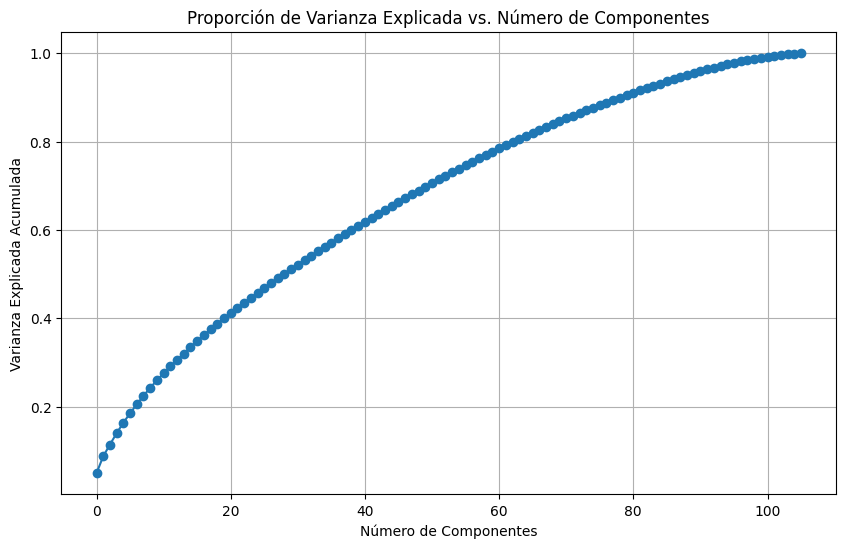

In [ ]:
# Seleccionar características numéricas para PCA
caracteristicas_numericas = df1.select_dtypes(include=np.number).columns
df1_numerico = df1[caracteristicas_numericas]

# Manejar valores faltantes (reemplazar con la media de cada columna)
df1_numerico = df1_numerico.fillna(df1_numerico.mean())

# Estandarizar los datos
escalar = StandardScaler()
df1_escalado = escalar.fit_transform(df1_numerico)

# Aplicar PCA
pca = PCA()
pca.fit(df1_escalado)

# Proporción de varianza explicada
varianza_explicada_ratio = pca.explained_variance_ratio_

# Graficar la varianza explicada acumulada
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(varianza_explicada_ratio), marker='o')
plt.title('Proporción de Varianza Explicada vs. Número de Componentes')
plt.xlabel('Número de Componentes')
plt.ylabel('Varianza Explicada Acumulada')
plt.grid(True)
plt.show()

*La gráfica ayuda a decidir cuántos componentes usar según la proporción de la varianza acumulada. Se interpreta que con 100 variables se conservará el 100% de la información.*

Para el analisis que estamo realizando, es adecuado quedarnos con el 95% de la información, ie, presercar el 95% de la varianza (o info) del conjunto de datos original. Las ventajas de realizar esto son:

*1. Mejora de la interpretabilidad: Al reducir el número de variables, el análisis se vuelve más manejable y comprensible sin una gran pérdida de información.*

*2. Eliminación de Ruido e Información Redundante: mejora la calidad de los datos y reduce el impacto de información irrelevante en el modelo, aumentando la precisión y la fiabilidad del análisis.*

*3. Facilita la Visualización de Datos*


In [ ]:
# Establecer el umbral de varianza deseado (por ejemplo, 95%)
umbral_varianza = 0.95

# Aplicar PCA con el umbral especificado
pca = PCA(n_components=umbral_varianza)
df1_pca = pca.fit_transform(df1_escalado)

# Obtener el número de componentes seleccionados
n_componentes_seleccionados = pca.n_components_

# Imprimir el número de componentes seleccionados
print(f"Número de componentes seleccionados: {n_componentes_seleccionados}")

# Crear un nuevo DataFrame con los datos reducidos
columnas_pca = [f"CP{i+1}" for i in range(n_componentes_seleccionados)]
dfPCA = pd.DataFrame(data=df1_pca, columns=columnas_pca, index=df1.index)

Número de componentes seleccionados: 89


Se crea el dataFrame con la reducción de dimensionalidad 'dfPCA'

In [ ]:
dfPCA.shape

(3767, 89)

In [ ]:
dfPCA.head()

,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,CP9,CP10,...,CP80,CP81,CP82,CP83,CP84,CP85,CP86,CP87,CP88,CP89
0,2.776380,0.337181,-1.986168,-1.161480,0.180962,-0.869676,3.457815,-0.948910,-1.007001,-0.407175,...,0.464816,0.197934,-0.854892,-0.047389,0.663312,-0.410937,-1.457113,-0.605837,0.301945,0.282024
1,2.642515,0.738816,-1.254427,0.634389,-0.558305,-2.196245,-0.685772,0.736718,-1.801956,0.011623,...,-0.249779,-0.830933,-2.846713,-1.107996,1.953153,-0.286666,0.414748,0.465259,1.742041,3.309556
2,1.497054,-1.473109,2.654530,2.754506,-0.883501,-1.647144,2.795791,-0.165230,2.055390,1.225720,...,-0.961247,0.493989,0.434219,-0.183583,0.666931,0.788272,-0.079666,0.341982,-0.721978,2.404037
3,-0.393341,-1.159396,1.762441,1.884334,-0.441935,-0.374949,0.854665,0.408130,-0.624780,1.397413,...,1.328056,-0.119131,0.026684,0.119742,-0.139817,-0.577391,0.184388,2.209680,0.893544,-0.384830
4,-0.933221,-1.130373,0.826804,-0.037466,0.409138,0.679507,0.646495,2.528499,1.512391,1.469126,...,-0.039485,0.671665,-0.726130,-0.400564,0.137501,-0.519650,-0.462030,-0.125831,0.583685,-0.971365


## c. Analisis de varianza

   Componente Principal  Varianza Explicada  Varianza Explicada Acumulada
0                   CP1            0.049229                      0.049229
1                   CP2            0.038238                      0.087466
2                   CP3            0.026710                      0.114176
3                   CP4            0.025521                      0.139697
4                   CP5            0.023895                      0.163592
5                   CP6            0.021216                      0.184807
6                   CP7            0.020498                      0.205305
7                   CP8            0.019227                      0.224532
8                   CP9            0.018041                      0.242573
9                  CP10            0.017072                      0.259645
10                 CP11            0.015841                      0.275485
11                 CP12            0.015391                      0.290876
12                 CP13            0.0

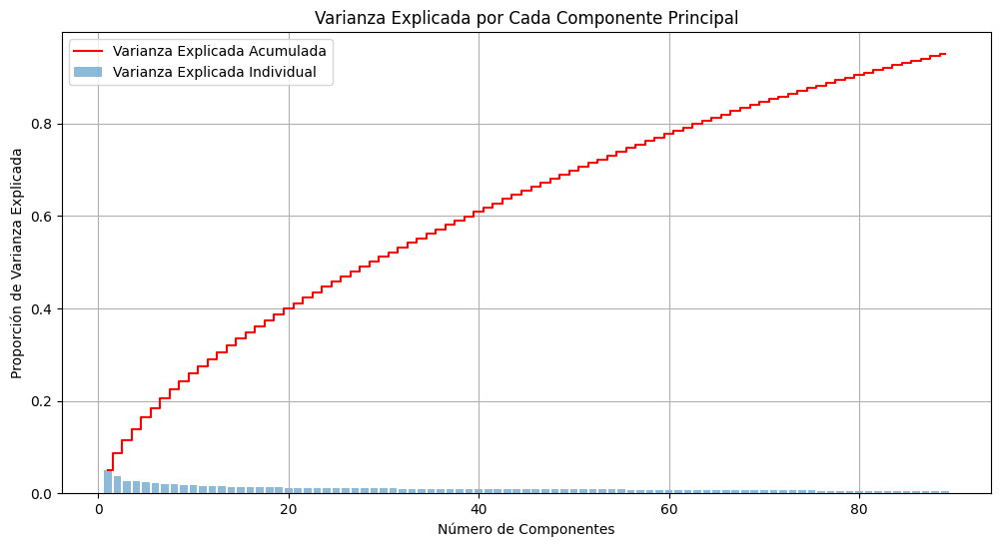

In [ ]:
# Obtener la varianza explicada de cada componente
varianza_explicada_ratio = pca.explained_variance_ratio_

# Crear un DataFrame para mostrar la varianza explicada por cada componente
df_varianza = pd.DataFrame({
    'Componente Principal': [f'CP{i+1}' for i in range(len(varianza_explicada_ratio))],
    'Varianza Explicada': varianza_explicada_ratio,
    'Varianza Explicada Acumulada': np.cumsum(varianza_explicada_ratio)
})

# Mostrar el DataFrame de varianza explicada
print(df_varianza)

# Graficar la varianza explicada y la varianza acumulada
plt.figure(figsize=(12, 6))

# Gráfico de varianza explicada por cada componente
plt.bar(range(1, len(varianza_explicada_ratio) + 1), varianza_explicada_ratio, alpha=0.5, align='center',
        label='Varianza Explicada Individual')
# Gráfico de varianza acumulada
plt.step(range(1, len(varianza_explicada_ratio) + 1), np.cumsum(varianza_explicada_ratio), where='mid',
         label='Varianza Explicada Acumulada', color='red')

plt.xlabel('Número de Componentes')
plt.ylabel('Proporción de Varianza Explicada')
plt.title('Varianza Explicada por Cada Componente Principal')
plt.legend(loc='best')
plt.grid(True)
plt.show()


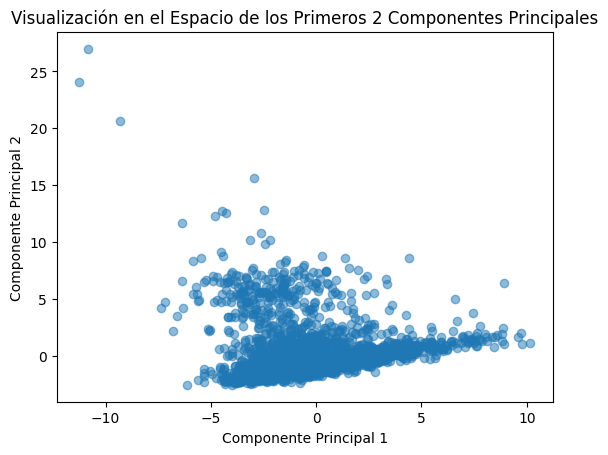

In [ ]:
plt.scatter(df1_pca[:, 0], df1_pca[:, 1], alpha=0.5)
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.title("Visualización en el Espacio de los Primeros 2 Componentes Principales")
plt.show()


In [ ]:
# Obtener los loadings (contribuciones de cada variable a los componentes principales)
loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'CP{i+1}' for i in range(n_componentes_seleccionados)],
    index=caracteristicas_numericas
)

# Mostrar las variables que más contribuyen al CP1
top_variables_CP1 = loadings['CP1'].abs().sort_values(ascending=False).head(5)
print("Variables que más contribuyen al CP1:")
print(top_variables_CP1)

# Mostrar las variables que más contribuyen al CP2
top_variables_CP2 = loadings['CP2'].abs().sort_values(ascending=False).head(5)
print("\n\nVariables que más contribuyen al CP2:")
print(top_variables_CP2)

Variables que más contribuyen al CP1:
nivel_alcanzado    0.275358
computadora        0.269177
internet           0.245074
cuartos_total      0.242190
tarj_bancaria      0.226109
Name: CP1, dtype: float64


Variables que más contribuyen al CP2:
padre_escuela    0.362327
padre_lee        0.354486
padre_vive       0.349399
sit_padre14      0.346957
sosten_hogar     0.261174
Name: CP2, dtype: float64


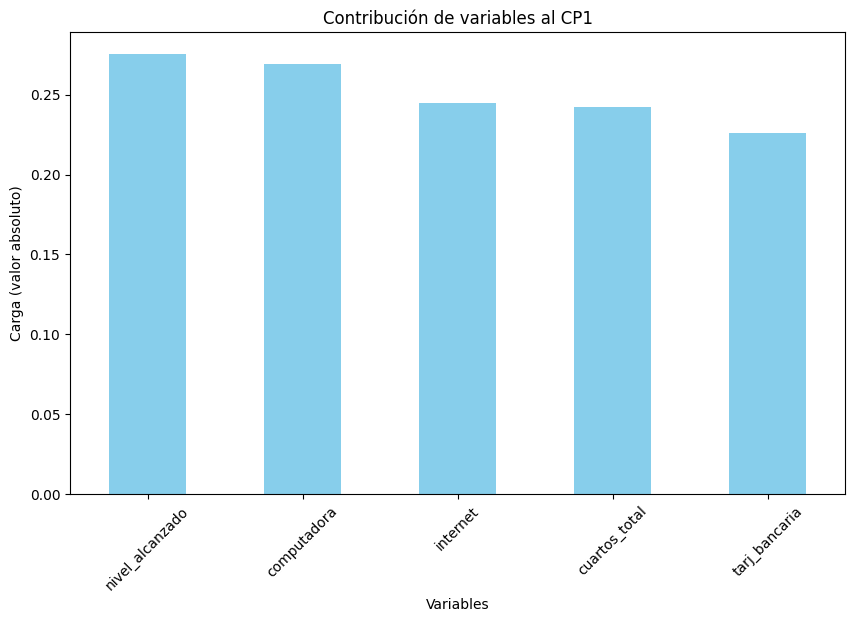

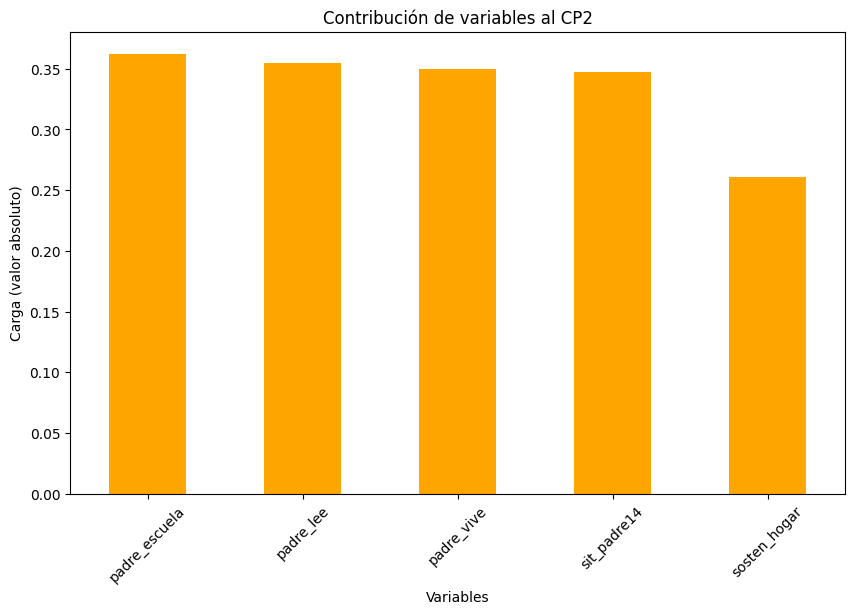

In [ ]:
# Visualizar las contribuciones al CP1
top_variables_CP1.plot(kind='bar', figsize=(10, 6), color='skyblue')
plt.title('Contribución de variables al CP1')
plt.ylabel('Carga (valor absoluto)')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.show()

# Visualizar las contribuciones al CP2
top_variables_CP2.plot(kind='bar', figsize=(10, 6), color='orange')
plt.title('Contribución de variables al CP2')
plt.ylabel('Carga (valor absoluto)')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.show()

## d. Método del codo en Clustering (K-means)



```
Se utiliza para encontrar el número óptimo de grupos (clusters). Las ventajas de utilizar este método son:
1. La facilidad de interpretación y visualización.
2. Balance entre complejidad y precisión.
4. Prevención de sobreajuste.
```




In [ ]:
# Determinar el número óptimo de grupos utilizando el método del codo
inercia = []
silhouette_scores = []
k_valores = range(2, 20)

for k in k_valores:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(dfPCA)
    inercia.append(kmeans.inertia_)
    labels = kmeans.labels_
    silhouette_avg = silhouette_score(dfPCA , labels)
    silhouette_scores.append(silhouette_avg)


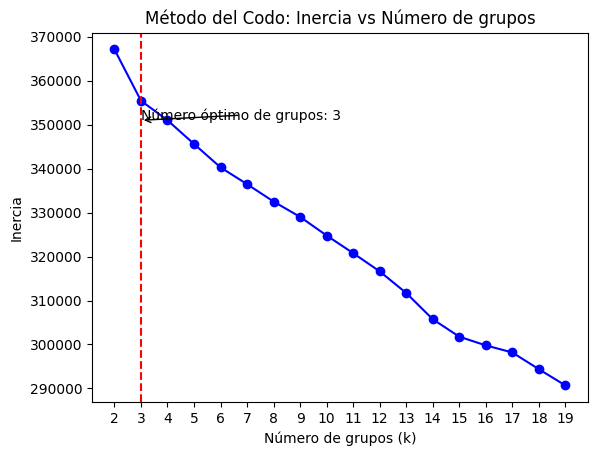

In [ ]:
# Graficar la curva de inercia
plt.plot(k_valores, inercia, 'bo-')
plt.xlabel('Número de grupos (k)')
plt.ylabel('Inercia')
plt.title('Método del Codo: Inercia vs Número de grupos')
plt.xticks(k_valores)

# Encontrar el número óptimo de grupos
optima_k = 3  # Establecer el número óptimo de grupos

# Dibujar la línea punteada perpendicular roja en el número óptimo de grupos
plt.axvline(x=optima_k, color='red', linestyle='--')
plt.annotate(f'Número óptimo de grupos: {optima_k}', xy=(optima_k, inercia[optima_k-1]), xytext=(optima_k, inercia[optima_k-1] + 200),
             arrowprops=dict(facecolor='black', arrowstyle='->'))

plt.show()

## e. Método de la silueta



```
Técnica para valuar la calidad de un modelo de clustering. Proporciona una
medida de cuán apropiado es el número de clusters elegido para el modelo.
1. Proporciona una Medida Clara de Calidad de Clustering
2. Independiente de la Escala y de la Densidad de los Clusters
3. Identifica Clusters Mal Agrupados
4. Visualización Intuitiva con el Gráfico de Silueta

```



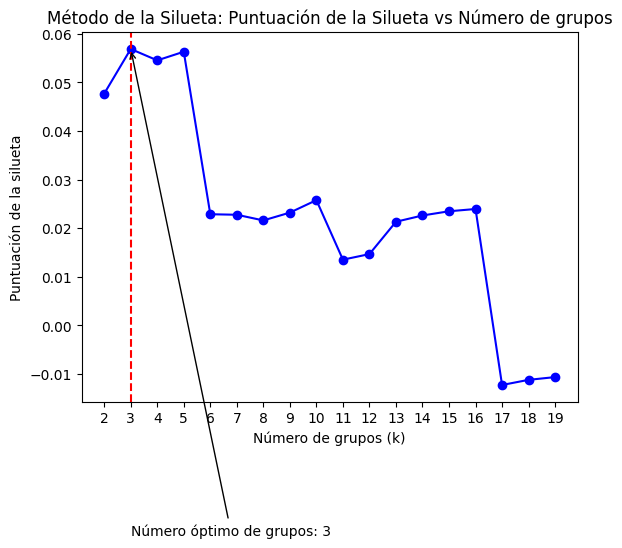

In [ ]:
# Graficar la curva de la silueta
plt.plot(k_valores, silhouette_scores, 'bo-')
plt.xlabel('Número de grupos (k)')
plt.ylabel('Puntuación de la silueta')
plt.title('Método de la Silueta: Puntuación de la Silueta vs Número de grupos')
plt.xticks(k_valores)

# Encontrar el número óptimo de grupos
optima_k = k_valores [np.argmax(silhouette_scores)]  # Obtener el valor de k con la puntuación de silueta máxima

# Dibujar la línea punteada perpendicular roja en el número óptimo de grupos
plt.axvline(x=optima_k, color='red', linestyle='--')
plt.annotate(f'Número óptimo de grupos: {optima_k}', xy=(optima_k, silhouette_scores[optima_k-2]),
             xytext=(optima_k, silhouette_scores[optima_k-2] - 0.1),
             arrowprops=dict(facecolor='black', arrowstyle='->'))

plt.show()

En este caso el método del codo y el método de la silueta nos arrojan clusters Iguales.



# 5. Caracteristicas de cada grupo



```
Después de haber realizado el PCA y haber determinado el número de grupos ideales.
Realizaremos la visualización de datos para determinar las caracteristicas de cada grupo.
```



## a. Visualización de Grupos

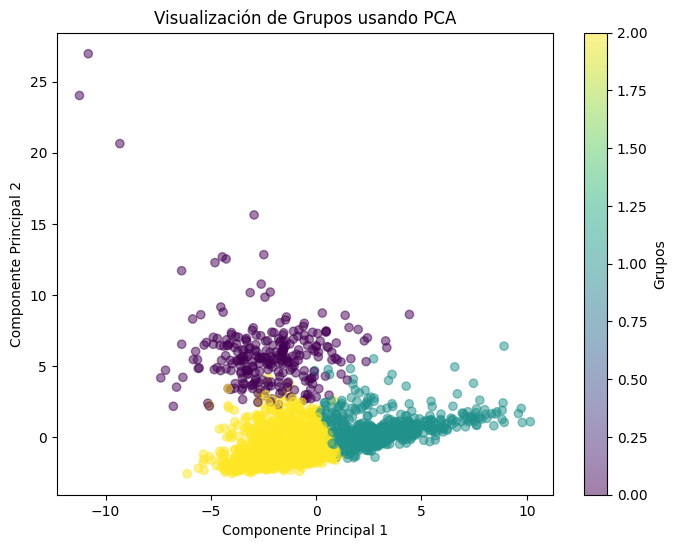

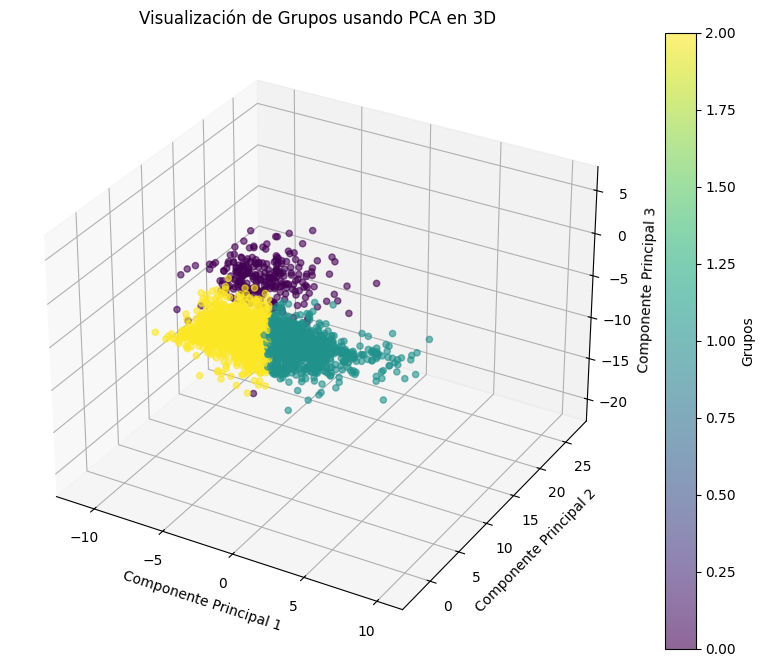

In [ ]:
# Aplicar KMeans con el número óptimo de grupos
kmeans_optimo = KMeans(n_clusters=optima_k, random_state=42)
clusters = kmeans_optimo.fit_predict(dfPCA)

# Paso 3: Aplicar PCA para reducir a 2 dimensiones
pca = PCA(n_components=2)
pcad = PCA(n_components=3)
df_pca = pca.fit_transform(dfPCA)
dfd_pca = pcad.fit_transform(dfPCA)

# Paso 4: Crear un DataFrame con las componentes principales y los clusters existentes
pca_df = pd.DataFrame(data=df_pca, columns=['CP1', 'CP2'])
pca_dfd = pd.DataFrame(data=dfd_pca, columns=['CP1', 'CP2', 'CP3'])
pca_df['cluster'] = clusters
pca_dfd['cluster'] = clusters

# Paso 5: Visualizar los clusters en el espacio PCA
plt.figure(figsize=(8, 6))
plt.scatter(pca_df['CP1'], pca_df['CP2'], c=pca_df['cluster'], cmap='viridis', alpha=0.5)
plt.title('Visualización de Grupos usando PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.colorbar(label='Grupos')
plt.show()

#Paso 5: Visualizar los clusters en el espacio PCA en 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(pca_dfd['CP1'], pca_dfd['CP2'], pca_dfd['CP3'], c=pca_dfd['cluster'], cmap='viridis', alpha=0.6)

# Etiquetas y color bar
ax.set_title('Visualización de Grupos usando PCA en 3D')
ax.set_xlabel('Componente Principal 1')
ax.set_ylabel('Componente Principal 2')
ax.set_zlabel('Componente Principal 3')
fig.colorbar(scatter, ax=ax, label='Grupos')

plt.show()

In [ ]:
import plotly.express as px

# Crear el gráfico 3D mejorado
fig = px.scatter_3d(
    pca_dfd,
    x='CP1',
    y='CP2',
    z='CP3',
    color='cluster',
    title='Grupos en Espacio PCA 3D',
    color_continuous_scale='Viridis',
    opacity=0.8,
    size_max=10
)

# Mejorar el diseño
fig.update_layout(
    scene=dict(
        xaxis_title='Componente Principal 1 (CP1)',
        yaxis_title='Componente Principal 2 (CP2)',
        zaxis_title='Componente Principal 3 (CP3)',
    ),
    margin=dict(l=0, r=0, b=0, t=30),  # Reducir márgenes
    width=800,
    height=800  # Ajustar tamaño
)

# Mostrar el gráfico
fig.show()
# Guardar el gráfico interactivo en un archivo HTML
fig.write_html("grafico_3d_pca.html")

# Descargar el archivo en tu computadora
from google.colab import files
files.download("grafico_3d_pca.html")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Colocamos los centroides

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


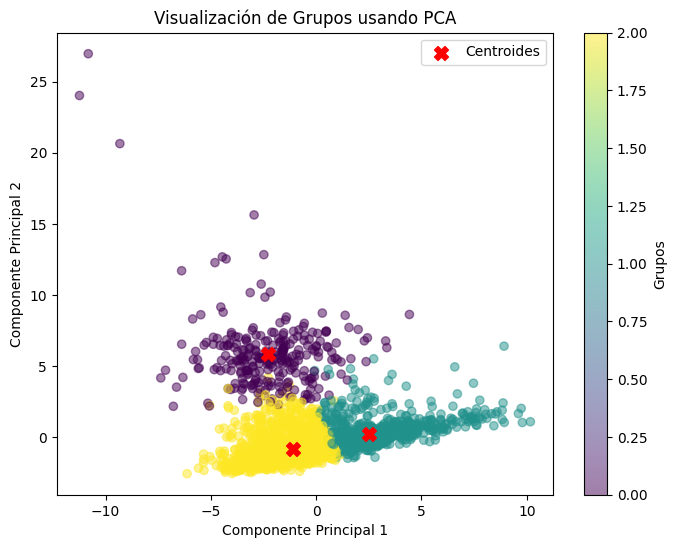

In [ ]:
# Calcular los centroides en el espacio original
centroides_originales = []
for i in np.unique(clusters):
    # Filtrar los puntos que pertenecen a cada cluster y calcular el centroide
    centroides_originales.append(dfPCA[clusters == i].mean(axis=0))
centroides_originales = np.array(centroides_originales)

# Transformar los centroides al espacio PCA
centroides_pca = pca.transform(centroides_originales)  # Centroides proyectados en el espacio de PCA

# Paso 5: Visualizar los clusters y los centroides en el espacio PCA
plt.figure(figsize=(8, 6))

# Graficar los puntos de datos con colores por cluster
scatter = plt.scatter(pca_df['CP1'], pca_df['CP2'], c=pca_df['cluster'], cmap='viridis', alpha=0.5)
plt.colorbar(label='Grupos')
plt.title('Visualización de Grupos usando PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')

# Graficar los centroides en el espacio de PCA
plt.scatter(centroides_pca[:, 0], centroides_pca[:, 1], c='red', marker='X', s=100, label='Centroides')
plt.legend(loc='upper right')
plt.show()

In [ ]:
df1['cluster'] = clusters
df1.head()

,rur_urb,total_hogar,edad_cumplida,sexo,asiste_escuela,nivel_alcanzado,año_alcanzado,actividad,entidad_14,tamaño_14,personas_14,cuartos_total14,cuartos_dormir14,agua_entubada14,electricidad14,baño_vivienda14,sit_vivienda14,tel_fijo14,celular14,computadora14,internet14,videocass_dvd14,otra_vivienda14,auto_propio14,cuenta_ahorro14,tarj_bancaria14,tarj_tienda14,alumbrado_p14,escuelas_cerca14,medicos_cerca14,guarderias_cerca14,esparcimiento14,seg_colonia14,facil_transp14,limpieza_calles14,padre_vive,madre_vive,edad_padre,edad_madre,sosten_hogar,padre_escuela,madre_escuela,nivel_padre,nivel_madre,grado_padre,grado_madre,padre_lee,madre_lee,sit_padre14,padre_puesto,padre_cargo,sit_madre,madre_razón_no_trab,madre_puesto,madre_cargo,guarderia,primaria_pubPriv,sec_pubPriv,prepa_pubPriv,sit_laboral,ha_trabajado,edad_ulTrabajo,razon_no_trab,sit_ocupación,seg_social,contrato_escrito,tipo_contrato,horas_semana,edad_1_trab,1_puesto,1_cargo,contrato_1,tipo_contrato_1,horas_1,num_hijos,edad_1_hijo,cuartos_dormir,cuartos_total,sit_vivienda,prop_vivienda,agua_vivienda,electric_vivienda,baño_vivienda,tel_fijo,cel,internet,tableta,computadora,cuenta_bancaria,tarj_bancaria,tarj_tienda,alumbrado_p,escuelas_cerca,medicos_cerca,guarderias_cerca,esparcimiento,seg_colonia,facil_transp,limpieza_calles,num_autos,miembros_ingreso,ingreso_total,ingreso_salMin,hogar_ubicacion,hogar_ubicacion14,lengua_indigena,cluster
0,1,4,30,1,2.0,6,3.0,1,19,1,5,5,3.0,1,1,1,3,1,2,2,2,2,2,2,1,999,999,1,1,1,1,1,1,1,2,2,2,70.0,65.0,2,2,1,NaN,3.0,NaN,NaN,NaN,NaN,1,3.0,1.0,6,NaN,3.0,2.0,1,1.0,1.0,1.0,1,NaN,NaN,NaN,1.0,1.0,1.0,2.0,64.0,18.0,1.0,2.0,2.0,NaN,10.0,1,NaN,3,6,1,NaN,1,1,1,1.0,1,1.0,2.0,1.0,1,2,2,1,1,1,1,1,1,1,1,0.0,1.0,0.1,NaN,5,3,2,1
1,1,3,39,2,2.0,3,3.0,1,14,2,5,5,3.0,1,1,1,3,2,2,2,2,1,2,2,1,2,1,1,1,1,999,1,1,1,1,1,1,68.0,62.0,2,1,1,2.0,999.0,6.0,NaN,NaN,NaN,1,1.0,2.0,7,8.0,NaN,NaN,2,1.0,1.0,NaN,1,NaN,NaN,NaN,1.0,1.0,1.0,1.0,40.0,14.0,1.0,2.0,2.0,NaN,40.0,2,18.0,2,6,1,NaN,1,1,1,1.0,1,1.0,1.0,1.0,1,1,2,1,1,1,1,999,1,1,1,1.0,2.0,0.2,4.0,5,5,2,1
2,1,7,36,1,2.0,2,4.0,1,19,3,20,5,4.0,1,1,1,3,2,2,2,2,1,2,2,2,2,2,2,1,2,2,1,2,2,1,1,2,58.0,53.0,2,2,1,NaN,2.0,NaN,NaN,1.0,NaN,1,1.0,2.0,5,NaN,5.0,NaN,2,1.0,NaN,NaN,5,2.0,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN,4,5,3,4.0,1,1,1,1.0,1,1.0,2.0,2.0,1,2,1,2,2,2,2,1,1,1,1,0.0,2.0,6000.0,NaN,5,5,2,1
3,1,5,39,2,2.0,4,3.0,6,19,2,6,5,2.0,1,1,1,3,2,2,2,2,1,2,1,2,2,2,1,1,1,1,1,1,1,1,1,1,72.0,63.0,2,1,1,11.0,2.0,2.0,6.0,NaN,NaN,1,1.0,1.0,1,NaN,1.0,2.0,2,1.0,1.0,NaN,5,1.0,38.0,8.0,NaN,NaN,NaN,NaN,NaN,14.0,1.0,2.0,1.0,1.0,48.0,5,20.0,3,5,1,NaN,1,1,1,2.0,1,2.0,1.0,2.0,2,2,2,2,1,1,999,1,2,1,2,0.0,2.0,0.2,4.0,4,4,2,2
4,1,5,31,2,2.0,4,3.0,6,19,5,5,3,2.0,2,1,2,3,2,2,2,2,2,2,2,2,2,2,1,1,1,2,1,2,2,1,1,1,72.0,67.0,2,2,2,NaN,NaN,NaN,NaN,1.0,1.0,1,5.0,NaN,6,NaN,5.0,NaN,2,1.0,1.0,NaN,1,NaN,NaN,NaN,3.0,5.0,2.0,NaN,6.0,21.0,1.0,2.0,1.0,1.0,8.0,3,NaN,2,3,2,NaN,1,1,1,2.0,1,1.0,2.0,1.0,1,2,2,2,2,1,2,1,2,2,2,0.0,1.0,0.1,NaN,5,3,2,2


Los centroides se calculan tomando el promedio de todas las observaciones (puntos) que pertenecen a un mismo cluster.

# 5.1

In [ ]:
df1

,rur_urb,total_hogar,edad_cumplida,sexo,asiste_escuela,nivel_alcanzado,año_alcanzado,actividad,entidad_14,tamaño_14,personas_14,cuartos_total14,cuartos_dormir14,agua_entubada14,electricidad14,baño_vivienda14,sit_vivienda14,tel_fijo14,celular14,computadora14,internet14,videocass_dvd14,otra_vivienda14,auto_propio14,cuenta_ahorro14,tarj_bancaria14,tarj_tienda14,alumbrado_p14,escuelas_cerca14,medicos_cerca14,guarderias_cerca14,esparcimiento14,seg_colonia14,facil_transp14,limpieza_calles14,padre_vive,madre_vive,edad_padre,edad_madre,sosten_hogar,padre_escuela,madre_escuela,nivel_padre,nivel_madre,grado_padre,grado_madre,padre_lee,madre_lee,sit_padre14,padre_puesto,padre_cargo,sit_madre,madre_razón_no_trab,madre_puesto,madre_cargo,guarderia,primaria_pubPriv,sec_pubPriv,prepa_pubPriv,sit_laboral,ha_trabajado,edad_ulTrabajo,razon_no_trab,sit_ocupación,seg_social,contrato_escrito,tipo_contrato,horas_semana,edad_1_trab,1_puesto,1_cargo,contrato_1,tipo_contrato_1,horas_1,num_hijos,edad_1_hijo,cuartos_dormir,cuartos_total,sit_vivienda,prop_vivienda,agua_vivienda,electric_vivienda,baño_vivienda,tel_fijo,cel,internet,tableta,computadora,cuenta_bancaria,tarj_bancaria,tarj_tienda,alumbrado_p,escuelas_cerca,medicos_cerca,guarderias_cerca,esparcimiento,seg_colonia,facil_transp,limpieza_calles,num_autos,miembros_ingreso,ingreso_total,ingreso_salMin,hogar_ubicacion,hogar_ubicacion14,lengua_indigena,cluster
0,1,4,30,1,2.0,6,3.0,1,19,1,5,5,3.0,1,1,1,3,1,2,2,2,2,2,2,1,999,999,1,1,1,1,1,1,1,2,2,2,70.0,65.0,2,2,1,NaN,3.0,NaN,NaN,NaN,NaN,1,3.0,1.0,6,NaN,3.0,2.0,1,1.0,1.0,1.0,1,NaN,NaN,NaN,1.0,1.0,1.0,2.0,64.0,18.0,1.0,2.0,2.0,NaN,10.0,1,NaN,3,6,1,NaN,1,1,1,1.0,1,1.0,2.0,1.0,1,2,2,1,1,1,1,1,1,1,1,0.0,1.0,0.1,NaN,5,3,2,1
1,1,3,39,2,2.0,3,3.0,1,14,2,5,5,3.0,1,1,1,3,2,2,2,2,1,2,2,1,2,1,1,1,1,999,1,1,1,1,1,1,68.0,62.0,2,1,1,2.0,999.0,6.0,NaN,NaN,NaN,1,1.0,2.0,7,8.0,NaN,NaN,2,1.0,1.0,NaN,1,NaN,NaN,NaN,1.0,1.0,1.0,1.0,40.0,14.0,1.0,2.0,2.0,NaN,40.0,2,18.0,2,6,1,NaN,1,1,1,1.0,1,1.0,1.0,1.0,1,1,2,1,1,1,1,999,1,1,1,1.0,2.0,0.2,4.0,5,5,2,1
2,1,7,36,1,2.0,2,4.0,1,19,3,20,5,4.0,1,1,1,3,2,2,2,2,1,2,2,2,2,2,2,1,2,2,1,2,2,1,1,2,58.0,53.0,2,2,1,NaN,2.0,NaN,NaN,1.0,NaN,1,1.0,2.0,5,NaN,5.0,NaN,2,1.0,NaN,NaN,5,2.0,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN,4,5,3,4.0,1,1,1,1.0,1,1.0,2.0,2.0,1,2,1,2,2,2,2,1,1,1,1,0.0,2.0,6000.0,NaN,5,5,2,1
3,1,5,39,2,2.0,4,3.0,6,19,2,6,5,2.0,1,1,1,3,2,2,2,2,1,2,1,2,2,2,1,1,1,1,1,1,1,1,1,1,72.0,63.0,2,1,1,11.0,2.0,2.0,6.0,NaN,NaN,1,1.0,1.0,1,NaN,1.0,2.0,2,1.0,1.0,NaN,5,1.0,38.0,8.0,NaN,NaN,NaN,NaN,NaN,14.0,1.0,2.0,1.0,1.0,48.0,5,20.0,3,5,1,NaN,1,1,1,2.0,1,2.0,1.0,2.0,2,2,2,2,1,1,999,1,2,1,2,0.0,2.0,0.2,4.0,4,4,2,2
4,1,5,31,2,2.0,4,3.0,6,19,5,5,3,2.0,2,1,2,3,2,2,2,2,2,2,2,2,2,2,1,1,1,2,1,2,2,1,1,1,72.0,67.0,2,2,2,NaN,NaN,NaN,NaN,1.0,1.0,1,5.0,NaN,6,NaN,5.0,NaN,2,1.0,1.0,NaN,1,NaN,NaN,NaN,3.0,5.0,2.0,NaN,6.0,21.0,1.0,2.0,1.0,1.0,8.0,3,NaN,2,3,2,NaN,1,1,1,2.0,1,1.0,2.0,1.0,1,2,2,2,2,1,2,1,2,2,2,0.0,1.0,0.1,NaN,5,3,2,2
5,1,3,39,1,2.0,6,3.0,1,30,5,5,4,3.0,2,1,2,3,2,2,2,2,2,2,2,2,2,2,2,1,1,2,1,1,1,1,2,1,83.0,63.0,3,1,1,2.0,2.0,6.0,6.0,NaN,NaN,9,NaN,NaN,1,NaN,NaN,NaN,2,1.0,1.0,1.0,1,NaN,NaN,NaN,1.0,1.0,1.0,1.0,48.0,18.0,1.0,2.0,1.0,1.0,50.0,1,37.0,2,3,3,1.0,1,1,1,2.0,1,2.0,2.0,1.0,2,2,2,1,1,1,1,1,1,1,1,0.0,1.0,5000.0,NaN,8,5,2,2
6,1,3,61,1,2.0,3,3.0,3,5,3,5,3,2.0,1,1,1,3,2,2,2,2,2,2,2,2,2,999,1,1,1,2,1,1,1,1,2,2,98.0,93.0,2,1,1,2.0,2.0,6.0,6.0,NaN,NaN,1,4.0,NaN,7,9.0,NaN,NaN,2,1.0,1.0,NaN,5,1.0,61.0,1.0,NaN,NaN,NaN,NaN,NaN,18.0,3.0,2.0,2.0,NaN,48.0,3,32.0,2,3,3,4.0,1,1,1,2.0,1,1.0,1.0,1.0,2,2,1,1,1,1,1,1,1,1,1,0.0,1.0,8000.0,NaN,2,2,2,2
7,1,2,44,1,NaN,4,3.0,1,19,1,8,2,2.0,1,1,1,2,2,1,2,2,1,2,2,2,2,2,1,1,1,1,1,2,1,2,2,2,67.0,71.0,3,1,1,2.0,2.0,6.0,6.0,NaN,NaN,1,5.0,NaN,3,NaN,4.0,NaN,2,1.0,1.0,NaN,1,NaN,NaN,NaN,4.0,5.0,2.0,NaN,35.0,14.0,6.0,NaN,NaN,NaN,35.0,2,NaN,1,5,3,1.0,1,1,1,2.0,1,2.0,2.0,2.0,2,2,2,2,1,1,1,1,2,1,2,0.0,2.0,2000.0,NaN,7,6,2,2
8,1,3,43,1,2.0,0,NaN,1,19,2,6,2,2.0,1,1,1,3,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,2,2,2,2,1,71.0,67.

In [ ]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
X = imputer.fit_transform(df1.drop(columns=['cluster']))
y = df1['cluster']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
classifiers = {
    "Random Forest": RandomForestClassifier(),
    "Logistic Regression": LogisticRegression(),
    "Support Vector Machine": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB()
}

In [ ]:
# Crear un diccionario para almacenar los resultados
results = {"Classifier": [], "Accuracy": [], "Precision": [], "Recall": [], "F1 Score": []}

In [ ]:
# Iterar sobre cada clasificador en el diccionario
for name, clf in classifiers.items():
    print(f"\nIniciando entrenamiento para: {name}...")  # Mensaje de inicio de entrenamiento

    # Crear un pipeline con estandarización y el clasificador
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('classifier', clf)
    ])

    # Entrenar el clasificador
    pipeline.fit(X_train, y_train)
    print(f"{name} - Entrenamiento completado.")  # Confirmación de entrenamiento completado

    # Hacer predicciones en el conjunto de prueba
    y_pred = pipeline.predict(X_test)
    print(f"{name} - Predicción en conjunto de prueba realizada.")  # Confirmación de predicción completada

    # Calcular las métricas de rendimiento
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average="weighted")
    recall = recall_score(y_test, y_pred, average="weighted")
    f1 = f1_score(y_test, y_pred, average="weighted")

    # Guardar los resultados
    results["Classifier"].append(name)
    results["Accuracy"].append(accuracy)
    results["Precision"].append(precision)
    results["Recall"].append(recall)
    results["F1 Score"].append(f1)

    # Mostrar las métricas calculadas para cada clasificador
    print(f"{name} - Métricas: "
          f"Exactitud (Accuracy): {accuracy:.4f}, "
          f"Precisión (Precision): {precision:.4f}, "
          f"Recuperación (Recall): {recall:.4f}, "
          f"Puntuación F1: {f1:.4f}")

# Convertir los resultados en un DataFrame
results_df = pd.DataFrame(results)
print("\nProceso completado. Resultados almacenados en 'results_df'.")



Iniciando entrenamiento para: Random Forest...
Random Forest - Entrenamiento completado.
Random Forest - Predicción en conjunto de prueba realizada.
Random Forest - Métricas: Exactitud (Accuracy): 0.9222, Precisión (Precision): 0.9224, Recuperación (Recall): 0.9222, Puntuación F1: 0.9218

Iniciando entrenamiento para: Logistic Regression...
Logistic Regression - Entrenamiento completado.
Logistic Regression - Predicción en conjunto de prueba realizada.
Logistic Regression - Métricas: Exactitud (Accuracy): 0.9699, Precisión (Precision): 0.9697, Recuperación (Recall): 0.9699, Puntuación F1: 0.9698

Iniciando entrenamiento para: Support Vector Machine...
Support Vector Machine - Entrenamiento completado.
Support Vector Machine - Predicción en conjunto de prueba realizada.
Support Vector Machine - Métricas: Exactitud (Accuracy): 0.9425, Precisión (Precision): 0.9431, Recuperación (Recall): 0.9425, Puntuación F1: 0.9419

Iniciando entrenamiento para: Decision Tree...
Decision Tree - Entren

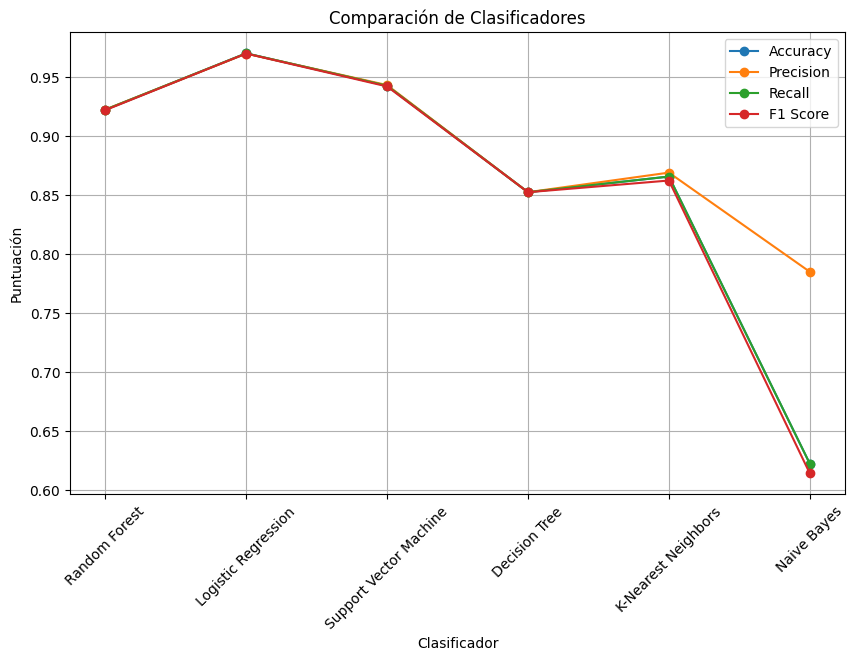

In [ ]:
# Graficar los resultados
plt.figure(figsize=(10, 6))
metrics = ["Accuracy", "Precision", "Recall", "F1 Score"]
for metric in metrics:
    plt.plot(results_df["Classifier"], results_df[metric], marker='o', label=metric)

plt.title("Comparación de Clasificadores")
plt.xlabel("Clasificador")
plt.ylabel("Puntuación")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

In [ ]:
# Mostrar la tabla con los resultados
pd.set_option('display.max_rows', None)  # Mostrar todas las filas si hay muchas
pd.set_option('display.max_columns', None)  # Mostrar todas las columnas si hay muchas
display(results_df)  # Esta es la forma de mostrar la tabla de manera interactiva en Jupyter

,Classifier,Accuracy,Precision,Recall,F1 Score
0,Random Forest,0.922193,0.922351,0.922193,0.921839
1,Logistic Regression,0.969938,0.969746,0.969938,0.969780
2,Support Vector Machine,0.942529,0.943068,0.942529,0.941925
3,Decision Tree,0.852343,0.852352,0.852343,0.852337
4,K-Nearest Neighbors,0.865606,0.868936,0.865606,0.862242
5,Naive Bayes,0.622458,0.784951,0.622458,0.614251


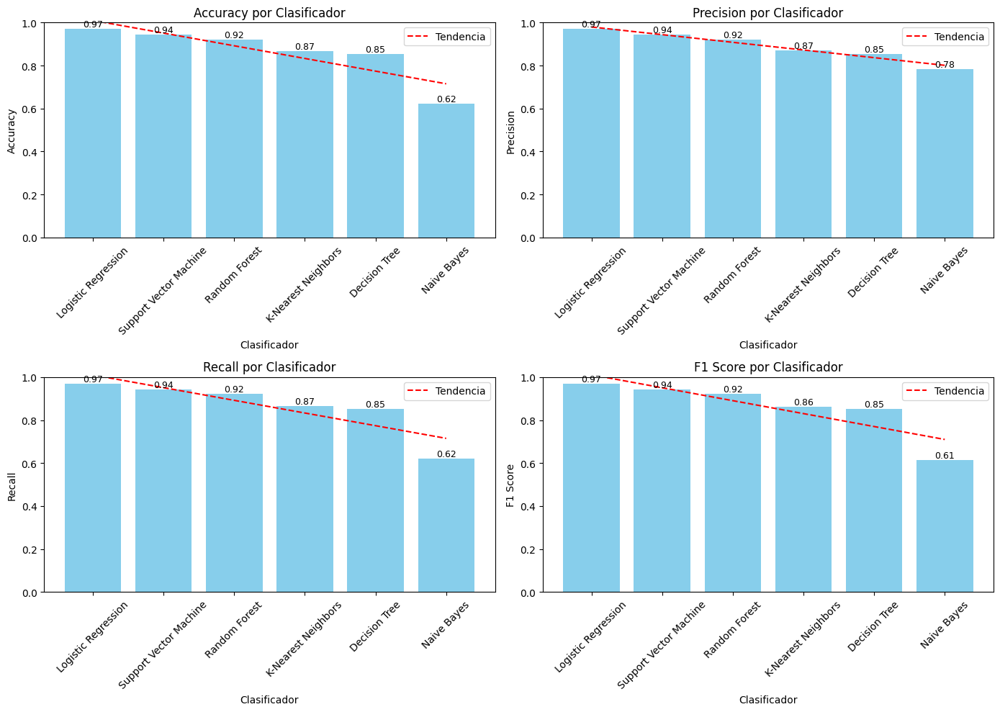


El mejor clasificador en términos de Accuracy es Logistic Regression con un Accuracy de 0.9699.


In [ ]:
# Establecer la métrica a usar para determinar el mejor clasificador
mejor_metrica = "Accuracy"  # Puedes cambiar "Accuracy" por "Precision", "Recall" o "F1 Score"
mejor_clasificador = results_df.loc[results_df[mejor_metrica].idxmax()]

# Graficar los resultados en un gráfico de barras
plt.figure(figsize=(14, 10))
metrics = ["Accuracy", "Precision", "Recall", "F1 Score"]

# Crear un gráfico de barras para cada métrica
for i, metric in enumerate(metrics, 1):
    plt.subplot(2, 2, i)  # Crear subgráficos en una cuadrícula 2x2
    valores_metric = results_df[metric]
    clasificadores = results_df["Classifier"]

    # Ordenar los valores y clasificadores de mayor a menor
    sorted_indices = np.argsort(valores_metric)[::-1]  # Ordenar en orden descendente
    valores_metric_sorted = valores_metric.iloc[sorted_indices]
    clasificadores_sorted = clasificadores.iloc[sorted_indices]

    # Crear gráfico de barras
    bars = plt.bar(clasificadores_sorted, valores_metric_sorted, color='skyblue')
    plt.title(f"{metric} por Clasificador")
    plt.xlabel("Clasificador")
    plt.ylabel(metric)
    plt.xticks(rotation=45)
    plt.ylim(0, 1)  # Para que todas las métricas estén en la misma escala

    # Agregar los valores en cada barra
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, yval, f"{yval:.2f}", ha="center", va="bottom", fontsize=9)

    # Agregar una línea de tendencia
    z = np.polyfit(range(len(valores_metric_sorted)), valores_metric_sorted, 1)
    p = np.poly1d(z)
    plt.plot(clasificadores_sorted, p(range(len(valores_metric_sorted))), color="red", linestyle="--", label="Tendencia")
    plt.legend()

plt.tight_layout()
plt.show()

# Mostrar el mejor clasificador según la métrica establecida
print(f"\nEl mejor clasificador en términos de {mejor_metrica} es {mejor_clasificador['Classifier']} "
      f"con un {mejor_metrica} de {mejor_clasificador[mejor_metrica]:.4f}.")

Support Vector Machine no se puede evaluar en ROC multiclase sin predict_proba.


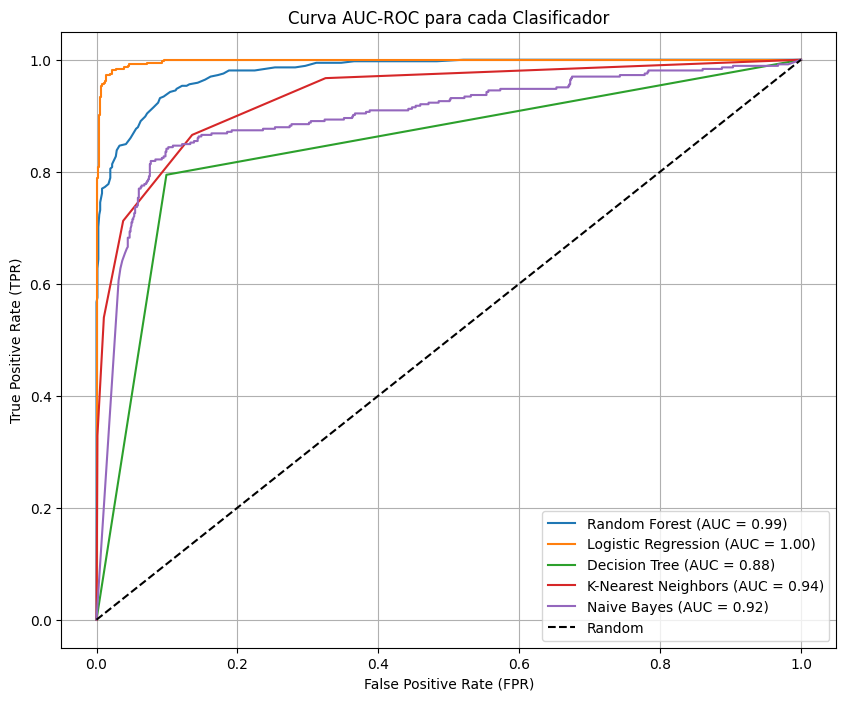


El mejor clasificador en términos de AUC es Logistic Regression con un AUC de 0.9974.


In [ ]:
# Crear el gráfico ROC para todos los clasificadores
plt.figure(figsize=(10, 8))
best_auc = 0
best_classifier = None

# Iterar sobre cada clasificador en el diccionario y calcular su ROC
for name, clf in classifiers.items():
    # Crear el pipeline de estandarización y el clasificador
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('classifier', clf)
    ])

    # Entrenar el clasificador
    pipeline.fit(X_train, y_train)

    # Comprobar si el clasificador tiene el método predict_proba
    if hasattr(clf, "predict_proba"):
        y_proba = pipeline.predict_proba(X_test)
    elif hasattr(clf, "decision_function"):
        # Si no tiene predict_proba, usa decision_function (solo para binario)
        y_proba = pipeline.decision_function(X_test)
        if len(set(y_test)) > 2:  # Si es multiclase, saltamos el clasificador
            print(f"{name} no se puede evaluar en ROC multiclase sin predict_proba.")
            continue
    else:
        print(f"{name} no tiene predict_proba ni decision_function.")
        continue

    # Calcular el AUC-ROC y la curva ROC
    if len(set(y_test)) > 2:  # Multiclase
        auc = roc_auc_score(y_test, y_proba, multi_class='ovr')
        # Calculamos fpr y tpr para cada clase en el caso multiclase
        fpr, tpr, _ = roc_curve(y_test, y_proba[:, 1], pos_label=1)
    else:  # Binario
        auc = roc_auc_score(y_test, y_proba)
        fpr, tpr, _ = roc_curve(y_test, y_proba)

    # Graficar la curva ROC de cada clasificador
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # Actualizar el mejor clasificador según el AUC
    if auc > best_auc:
        best_auc = auc
        best_classifier = name

# Graficar la línea diagonal de referencia
plt.plot([0, 1], [0, 1], 'k--', label="Random")

# Configuración del gráfico
plt.title("Curva AUC-ROC para cada Clasificador")
plt.xlabel("False Positive Rate (FPR)")
plt.ylabel("True Positive Rate (TPR)")
plt.legend(loc="lower right")
plt.grid()

# Mostrar el gráfico
plt.show()

# Mostrar el mejor clasificador en términos de AUC
print(f"\nEl mejor clasificador en términos de AUC es {best_classifier} con un AUC de {best_auc:.4f}.")


La gráfica muestra las curvas ROC para varios clasificadores, junto con el valor del AUC (Area Under the Curve) para cada uno. Aquí te presento una interpretación de cada elemento en esta gráfica:

### 1. **Curva ROC**:
   - La curva ROC (Receiver Operating Characteristic) es una representación de la relación entre la **Tasa de Verdaderos Positivos** (TPR) y la **Tasa de Falsos Positivos** (FPR) a medida que varía el umbral de decisión del clasificador.
   - Una curva más cercana a la esquina superior izquierda (FPR bajo, TPR alto) indica un mejor rendimiento, ya que maximiza la TPR mientras minimiza la FPR.

### 2. **AUC (Area Under the Curve)**:
   - El AUC es una medida de la capacidad de un modelo para distinguir entre clases. Un AUC de 1.0 representa un clasificador perfecto, mientras que un AUC de 0.5 indica un clasificador sin poder de discriminación (equivalente a una decisión aleatoria).
   - Un AUC más alto sugiere un mejor rendimiento en términos de sensibilidad y especificidad combinadas.

### Interpretación de Cada Clasificador:

1. **Logistic Regression (AUC = 1.00)**:
   - **Curva casi perfecta**: La curva se encuentra casi pegada a la esquina superior izquierda, y el AUC es 1.0, lo que indica un rendimiento perfecto en este conjunto de datos.
   - **Conclusión**: Logistic Regression logra una separación completa entre las clases, siendo el modelo con el mejor rendimiento.

2. **Random Forest (AUC = 0.99)**:
   - **Curva excelente**: Aunque no es perfecta, la curva ROC de Random Forest está muy cerca de la esquina superior izquierda, indicando un rendimiento casi perfecto.
   - **Conclusión**: Random Forest es muy eficaz para clasificar en este conjunto de datos, siendo solo ligeramente inferior a Logistic Regression.

3. **K-Nearest Neighbors (AUC = 0.94)**:
   - **Buen rendimiento**: La curva ROC de KNN es inferior a las de Logistic Regression y Random Forest, pero aún tiene un AUC alto de 0.94, lo que indica un rendimiento sólido.
   - **Conclusión**: KNN clasifica bien, pero no es tan eficaz como los dos primeros modelos.

4. **Naive Bayes (AUC = 0.92)**:
   - **Buen rendimiento**: Con un AUC de 0.92, Naive Bayes tiene un rendimiento aceptable, aunque menor que KNN, Random Forest y Logistic Regression.
   - **Conclusión**: Naive Bayes es una opción razonable, aunque existen modelos con mejor capacidad de discriminación en este conjunto.

5. **Decision Tree (AUC = 0.87)**:
   - **Rendimiento moderado**: El AUC de 0.87 indica que Decision Tree tiene una menor capacidad de discriminación en comparación con los otros modelos. Su curva ROC es la que se encuentra más alejada de la esquina superior izquierda.
   - **Conclusión**: Decision Tree no clasifica tan bien en este conjunto de datos y es el modelo con el menor rendimiento en comparación con los demás.

### Conclusión General:
- **Logistic Regression** y **Random Forest** son los modelos con mejor rendimiento en esta prueba, con AUCs de 1.0 y 0.99, respectivamente. Estos modelos ofrecen una excelente capacidad para diferenciar entre las clases.
- **K-Nearest Neighbors** y **Naive Bayes** también muestran un buen rendimiento, aunque están por debajo de Logistic Regression y Random Forest.
- **Decision Tree** es el modelo menos efectivo en este conjunto de datos, con un AUC de 0.87.

Si buscas maximizar la capacidad de discriminación entre las clases, **Logistic Regression** es la opción ideal, seguida de cerca por **Random Forest**.

**¿Por qué el AUC-ROC es la mejor métrica para evaluar el desempeño de clasificadores?**

- **Independiente del umbral**: No depende de un umbral específico para clasificar las muestras, lo que permite evaluar el modelo en todos los posibles umbrales.
  
- **Mide la capacidad de discriminación**: Evalúa qué tan bien el modelo puede distinguir entre las clases positivas y negativas.

- **Robusto frente a clases desbalanceadas**: Es menos afectado por el desbalance de clases, a diferencia de métricas como la exactitud.

- **Facilidad para comparar clasificadores**: Permite comparar fácilmente el rendimiento de diferentes modelos con una métrica única.

- **Interpretación intuitiva**: Un AUC de 0.5 indica un modelo aleatorio, y 1.0 un modelo perfecto, lo que facilita su comprensión.

- **Refleja un balance entre falsos positivos y verdaderos positivos**: Muestra cómo cambia el rendimiento del modelo a medida que varía el umbral de clasificación.

A todas estas, el AUC-ROC es preferido por su versatilidad, robustez ante desbalances de clase, capacidad para comparar modelos y su interpretación clara.


# Regresión logistica

## a) Variable dependiente (categorica) nivel_ingreso

In [ ]:
VF = df1['ingreso_salMin'].mode()[0]
df1['ingreso_salMin'] = df1['ingreso_salMin'].fillna(VF)
print(df1['ingreso_salMin'].describe())

count    3767.000000
mean       77.714892
std       262.106714
min         1.000000
25%         3.000000
50%         3.000000
75%         3.000000
max       999.000000
Name: ingreso_salMin, dtype: float64


In [ ]:
# Definir los límites (ajusta según tu contexto)
bins = [1, 3, 4, 7]  # Cambia los valores según tus datos
labels = ['Bajo', 'Medio', 'Alto']

# Clasificar manualmente
df1['nivel_ingreso'] = pd.cut(
    df1['ingreso_salMin'],
    bins=bins,
    labels=labels,
    include_lowest=True
)

# Verificar la clasificación
print(df1[['ingreso_salMin', 'nivel_ingreso']].head())

   ingreso_salMin nivel_ingreso
0             3.0          Bajo
1             4.0         Medio
2             3.0          Bajo
3             4.0         Medio
4             3.0          Bajo


In [ ]:
# Contar cuántos registros hay en cada nivel de ingreso
conteo_niveles = df1['nivel_ingreso'].value_counts()

# Imprimir el conteo
print(conteo_niveles)

nivel_ingreso
Bajo     3148
Medio     136
Alto       88
Name: count, dtype: int64


In [ ]:
# Contar valores nulos en la variable 'nivel_ingreso'
nulos = df1['nivel_ingreso'].isnull().sum()
nulos

395

In [ ]:
# Calcular el porcentaje de valores nulos
total = len(df1)
porcentaje_nulos = (nulos / total) * 100

# Mostrar el resultado
print(f"Porcentaje de valores nulos en 'nivel_ingreso': {porcentaje_nulos:.2f}%")

Porcentaje de valores nulos en 'nivel_ingreso': 10.49%


In [ ]:
df1 = df1.dropna(subset=['nivel_ingreso'])
df1['nivel_ingreso'].isnull().sum()

0

## b.Variables independientes


```
nivel_alcanzado
sexo
rur_urb
actividad
edad_cumplida
tipo_contrato
```



In [ ]:
# Seleccionar variables independientes y dependiente
X = df1[['nivel_alcanzado', 'sexo', 'rur_urb', 'actividad', 'edad_cumplida', 'tipo_contrato']]
y = df1['nivel_ingreso']

In [ ]:
mod = df1['tipo_contrato'].mode()[0]
df1['tipo_contrato'] = df1['tipo_contrato'].fillna(mod)

In [ ]:
print(X.isnull().sum())

nivel_alcanzado    0
sexo               0
rur_urb            0
actividad          0
edad_cumplida      0
tipo_contrato      0
dtype: int64


In [ ]:
# Codificar variables categóricas en dummies (excluyendo la primera para evitar colinealidad)
X = pd.get_dummies(X, drop_first=True)

# Escalar la variable edad
scaler = StandardScaler()
X['edad_cumplida'] = scaler.fit_transform(X[['edad_cumplida']])
# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
print(X_train.isnull().sum().sum())  # Debe ser 0

0


In [ ]:
# Verificar la distribución de clases en el conjunto de entrenamiento
print("Distribución de clases antes del balanceo:")
print(y_train.value_counts())

Distribución de clases antes del balanceo:
nivel_ingreso
Bajo     2199
Medio      94
Alto       67
Name: count, dtype: int64


## c. RL

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.metrics import recall_score

# Paso 1: Dividir los datos en entrenamiento y prueba
validation_size = 0.20
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=validation_size, random_state=seed)

# Paso 2: Aplicar SMOTE para balancear las clases en el conjunto de entrenamiento
smote = SMOTE(random_state=42)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)

# Verificar la nueva distribución de clases
print("Distribución de clases después de aplicar SMOTE:")
print(pd.Series(y_train_balanced).value_counts())

# Paso 3: Ajustar el modelo de regresión logística multinomial
model = LogisticRegression(solver='lbfgs', max_iter=5000)
model.fit(X_train_balanced, y_train_balanced)

# Paso 4: Evaluar el modelo
# Predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Evaluación de desempeño

print("\nRecall para cada clase:")
# Calcular el recall para cada clase
recall_por_clase = recall_score(y_test, y_pred, average=None)
# Mostrar el recall por clase
for clase, recall in zip(model.classes_, recall_por_clase):
    print(f"Clase: {clase}, Recall: {recall:.2f}")


# Paso 5: Importancia de las variables
# Extraer los coeficientes
coef = model.coef_
classes = model.classes_

# Crear un DataFrame con los coeficientes
coef_df = pd.DataFrame(coef.T, index=X_train.columns, columns=classes)

# Mostrar la tabla de coeficientes
print("\nImportancia de las variables por clase:")
print(coef_df)

# Calcular la importancia absoluta (magnitud)
importance = coef_df.abs().sum(axis=1).sort_values(ascending=False)

# Mostrar las variables más importantes
print("\nVariables más importantes (basadas en magnitud):")
print(importance)


Distribución de clases después de aplicar SMOTE:
nivel_ingreso
Bajo     2514
Medio    2514
Alto     2514
Name: count, dtype: int64

Recall para cada clase:
Clase: Alto, Recall: 0.50
Clase: Bajo, Recall: 0.42
Clase: Medio, Recall: 0.29

Importancia de las variables por clase:
                     Alto      Bajo     Medio
nivel_alcanzado  0.151298 -0.056188 -0.095109
sexo            -0.213752  0.562799 -0.349048
rur_urb         -0.396120  1.627594 -1.231474
actividad       -0.080268 -0.037815  0.118083
edad_cumplida    0.100284  0.167083 -0.267367
tipo_contrato    0.176885 -0.512885  0.336001

Variables más importantes (basadas en magnitud):
rur_urb            3.255189
sexo               1.125599
tipo_contrato      1.025771
edad_cumplida      0.534735
nivel_alcanzado    0.302595
actividad          0.236167
dtype: float64


### Rural/Urbano

In [ ]:
# Obtener las probabilidades predichas para el conjunto de prueba
probabilidades = model.predict_proba(X_test)

# Crear un DataFrame con las probabilidades y las categorías de 'rur_urb'
df_test = X_test.copy()
df_test['Clase_Predicha'] = model.predict(X_test)
df_test['Probabilidad_Bajo'] = probabilidades[:, 0]
df_test['Probabilidad_Medio'] = probabilidades[:, 1]
df_test['Probabilidad_Alto'] = probabilidades[:, 2]

# Calcular las probabilidades promedio por categoría de 'rur_urb'
promedios_rur_urb = df_test.groupby('rur_urb')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()
# Reemplazar los valores de 1 y 2 por "Urbano" y "Rural"
promedios_rur_urb.rename(index={1: 'Urbano', 2: 'Rural'}, inplace=True)

# Mostrar los resultados
print("\nPromedios de probabilidades por categoría de 'rur_urb':")
print(promedios_rur_urb)



Promedios de probabilidades por categoría de 'rur_urb':
         Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
rur_urb                                                          
Urbano            0.318690            0.341754           0.339556
Rural             0.077961            0.864356           0.057682


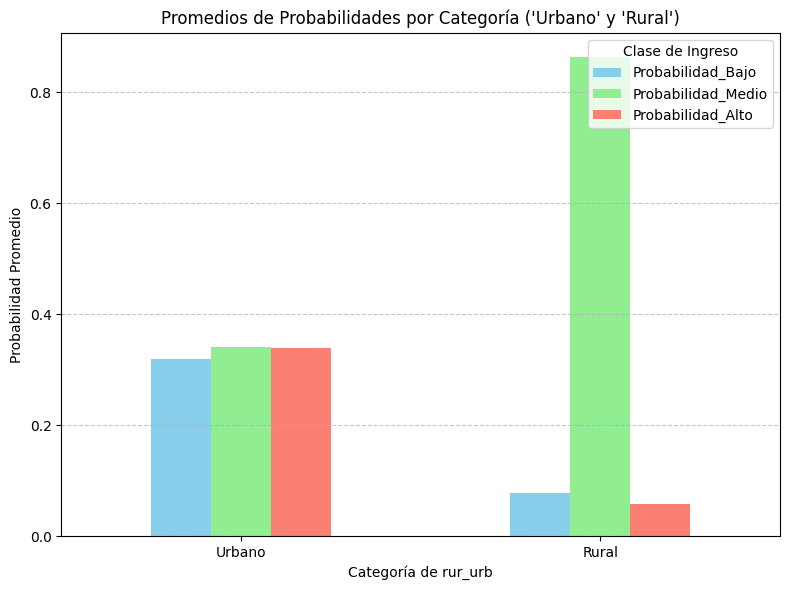

In [ ]:
# Crear un gráfico de barras
promedios_rur_urb.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue', 'lightgreen', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Categoría ('Urbano' y 'Rural')")
plt.ylabel("Probabilidad Promedio")
plt.xlabel("Categoría de rur_urb")
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

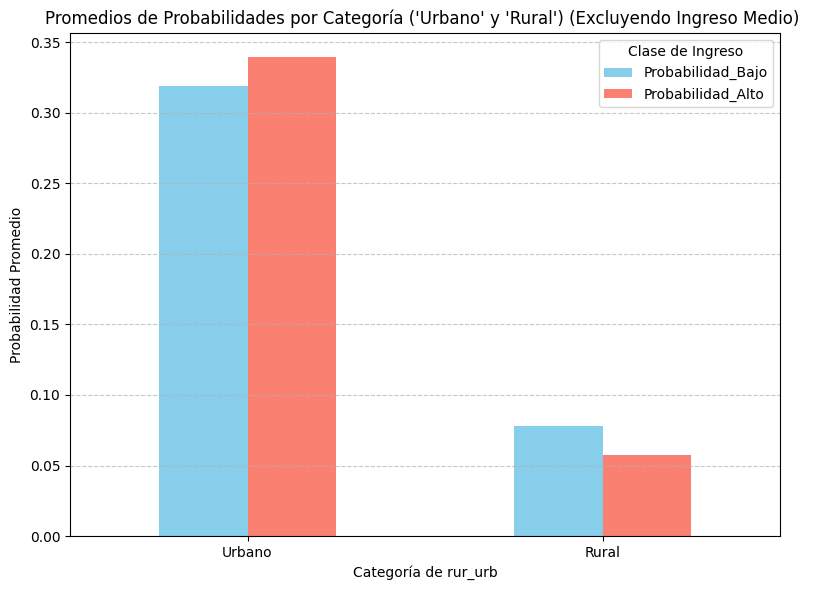

In [ ]:
# Excluir la clase "Probabilidad_Medio"
promedios_sin_medio = promedios_rur_urb.drop(columns=['Probabilidad_Medio'])

# Crear un gráfico de barras
promedios_sin_medio.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue','salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Categoría ('Urbano' y 'Rural') (Excluyendo Ingreso Medio) ")
plt.ylabel("Probabilidad Promedio")
plt.xlabel("Categoría de rur_urb")
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

**Para Urbanos (rur_urb = 1):**

Las probabilidades están distribuidas de manera más uniforme entre las tres clases (Bajo, Medio, Alto).
La clase "Medio" es ligeramente más representativa, pero no hay una dominancia clara.

**Para Rurales (rur_urb = 2):**

La gran mayoría pertenece a la clase "Medio".
Las clases "Bajo" y "Alto" tienen muy poca representación.

### Tipo Contrato

In [ ]:
# Calcular las probabilidades promedio por categoría de 'tipo_contrato'
promedios_tipo_contrato = df_test.groupby('tipo_contrato')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()

# Reemplazar los valores numéricos de tipo_contrato por descripciones
promedios_tipo_contrato.rename(index={
    1: 'Temporal',
    2: 'Base',
    3: 'Capacitación',
    4: 'Período de Prueba',
    5: 'Hasta término de obra'
}, inplace=True)

# Mostrar los resultados
print("\nPromedios de probabilidades por categoría de 'tipo_contrato':")
print(promedios_tipo_contrato.to_string())


Promedios de probabilidades por categoría de 'tipo_contrato':
                       Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
tipo_contrato                                                                  
Temporal                        0.255660            0.597680           0.146661
Base                            0.289951            0.399107           0.310942
Hasta término de obra           0.359116            0.421326           0.219558


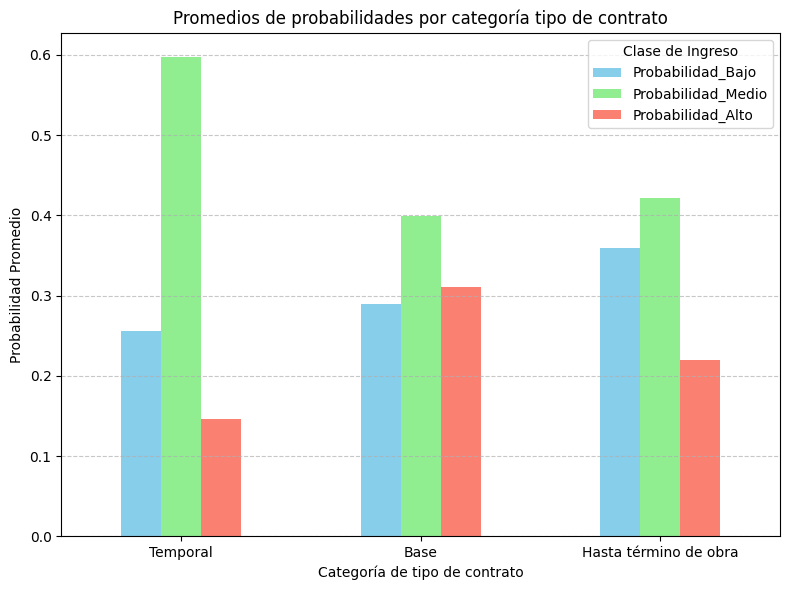

In [ ]:
# Crear un gráfico de barras
promedios_tipo_contrato.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue', 'lightgreen', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de probabilidades por categoría tipo de contrato")
plt.ylabel("Probabilidad Promedio")
plt.xlabel("Categoría de tipo de contrato")
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

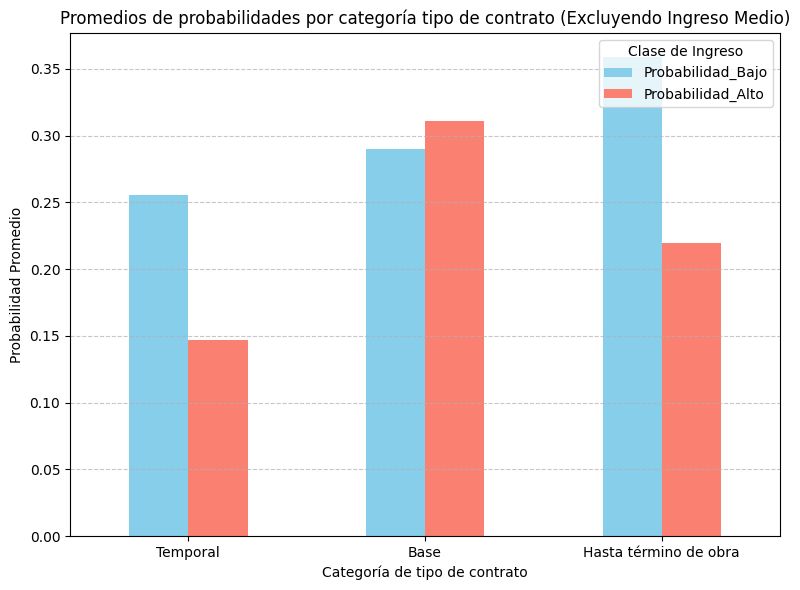

In [ ]:
# Excluir la clase "Probabilidad_Medio"
promedios_sin_medio = promedios_tipo_contrato.drop(columns=['Probabilidad_Medio'])

# Crear un gráfico de barras
promedios_sin_medio.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de probabilidades por categoría tipo de contrato (Excluyendo Ingreso Medio)")
plt.ylabel("Probabilidad Promedio")
plt.xlabel("Categoría de tipo de contrato")
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Sexo

In [ ]:
# Calcular las probabilidades promedio por categoría de 'sexo'
promedios_sexo = df_test.groupby('sexo')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()

# Reemplazar los valores numéricos de 'sexo' por descripciones
promedios_sexo.rename(index={1: 'Hombre', 2: 'Mujer', 3:'Otro'}, inplace=True)
# Mostrar los resultados
print("\nPromedios de probabilidades por sexo:")
print(promedios_sexo.to_string())


Promedios de probabilidades por sexo:
        Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
sexo                                                            
Hombre           0.373648            0.317418           0.308935
Mujer            0.233171            0.465412           0.301417
Otro             0.089556            0.557208           0.353235


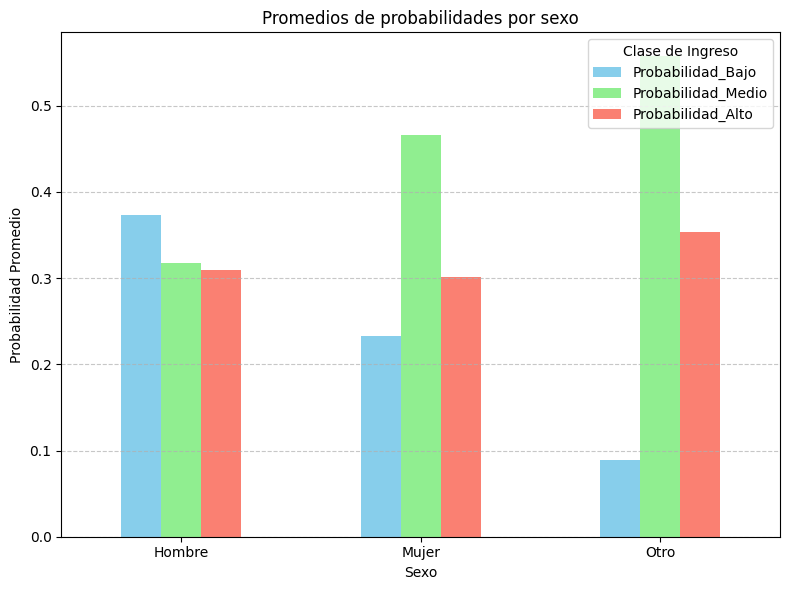

In [ ]:
# Crear un gráfico de barras
promedios_sexo.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue', 'lightgreen', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de probabilidades por sexo")
plt.ylabel("Probabilidad Promedio")
plt.xlabel("Sexo")
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

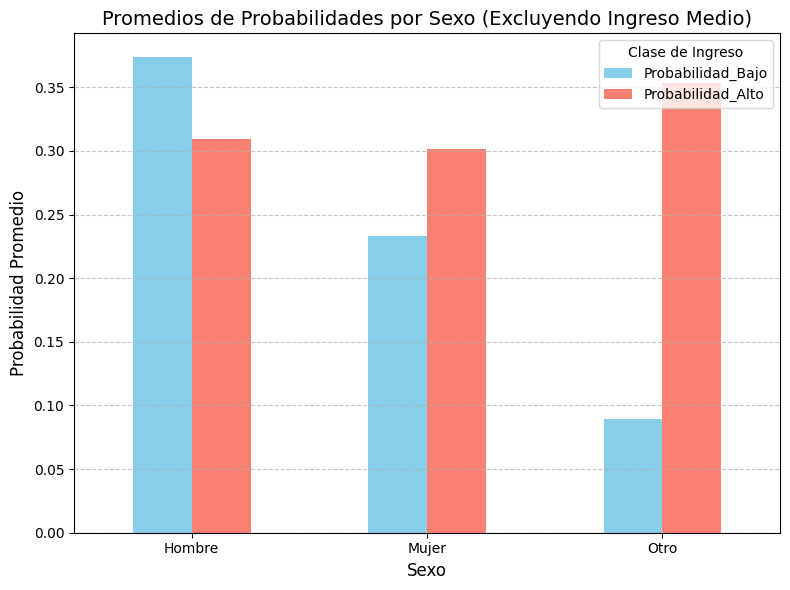

In [ ]:
# Crear un gráfico de barras excluyendo "Probabilidad_Medio"
promedios_sin_medio_sexo = promedios_sexo.drop(columns=['Probabilidad_Medio'])
promedios_sin_medio_sexo.plot(
    kind='bar',
    figsize=(8, 6),
    rot=0,
    color=['skyblue', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Sexo (Excluyendo Ingreso Medio)", fontsize=14)
plt.ylabel("Probabilidad Promedio", fontsize=12)
plt.xlabel("Sexo", fontsize=12)
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Nivel alcanzado

In [ ]:
# Obtener las probabilidades predichas para el conjunto de prueba
probabilidades = model.predict_proba(X_test)

# Crear un DataFrame con las probabilidades y las categorías de 'rur_urb'
df_test = X_test.copy()
df_test['Clase_Predicha'] = model.predict(X_test)
df_test['Probabilidad_Bajo'] = probabilidades[:, 2]
df_test['Probabilidad_Medio'] = probabilidades[:, 1]
df_test['Probabilidad_Alto'] = probabilidades[:, 0]

# Calcular las probabilidades promedio por categoría de 'nivel_alcanzado'
promedios_nivel_alcanzado = df_test.groupby('nivel_alcanzado')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()

# Reemplazar los valores numéricos de 'nivel_alcanzado' por descripciones
promedios_nivel_alcanzado.rename(index={
    0: 'No fue a la escuela',
    1: 'Preescolar',
    2: 'Primaria',
    3: 'SecundariaT',
    4: 'SecundariaG',
    5: 'PrepaT',
    6: 'PrepaG',
    7: 'TécnicaS',
    8: 'TécnicaP',
    9: 'Normal Básica',
    10: 'Normal Licenciatura',
    11: 'Profesional',
    12: 'Postgrado'
}, inplace=True)

# Mostrar los resultados
print("\nPromedios de probabilidades por nivel educativo:")
print(promedios_nivel_alcanzado.to_string())


Promedios de probabilidades por nivel educativo:
                     Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
nivel_alcanzado                                                              
No fue a la escuela           0.280205            0.631268           0.088527
Primaria                      0.286220            0.560157           0.153623
SecundariaT                   0.391668            0.377979           0.230353
SecundariaG                   0.339214            0.415782           0.245004
PrepaT                        0.361401            0.317675           0.320924
PrepaG                        0.305107            0.341550           0.353343
TécnicaS                      0.221666            0.378819           0.399515
TécnicaP                      0.198034            0.229807           0.572160
Normal Básica                 0.210322            0.252624           0.537053
Normal Licenciatura           0.176813            0.227894           0.595294
Profesional   

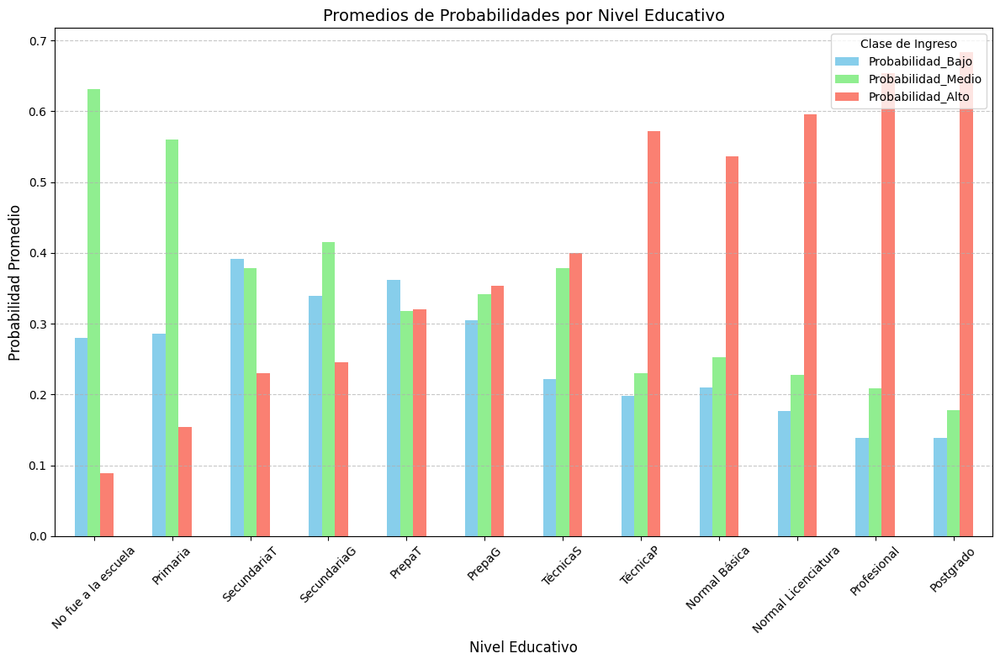

In [ ]:
# Crear un gráfico de barras
promedios_nivel_alcanzado.plot(
    kind='bar',
    figsize=(12, 8),
    rot=45,
    color=['skyblue', 'lightgreen', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Nivel Educativo", fontsize=14)
plt.ylabel("Probabilidad Promedio", fontsize=12)
plt.xlabel("Nivel Educativo", fontsize=12)
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

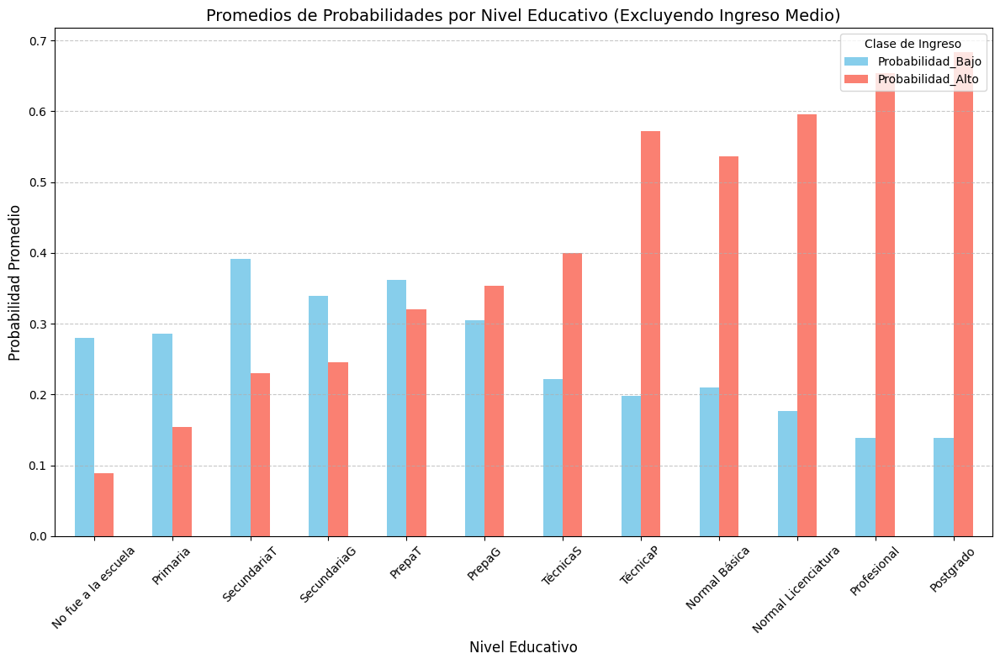

In [ ]:
# Crear un gráfico de barras excluyendo "Probabilidad_Medio"
promedios_sin_medio_nivel = promedios_nivel_alcanzado.drop(columns=['Probabilidad_Medio'])
promedios_sin_medio_nivel.plot(
    kind='bar',
    figsize=(12, 8),
    rot=45,
    color=['skyblue', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Nivel Educativo (Excluyendo Ingreso Medio)", fontsize=14)
plt.ylabel("Probabilidad Promedio", fontsize=12)
plt.xlabel("Nivel Educativo", fontsize=12)
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Edad cumplida

In [ ]:
# Calcular probabilidades promedio por categoría de 'edad_cumplida'
# Obtener las probabilidades predichas para el conjunto de prueba
probabilidades = model.predict_proba(X_test)

# Crear un DataFrame con las probabilidades y las categorías de 'edad_cumplida'
df_test = X_test.copy()
df_test['Clase_Predicha'] = model.predict(X_test)
df_test['Probabilidad_Bajo'] = probabilidades[:, 0]
df_test['Probabilidad_Medio'] = probabilidades[:, 1]
df_test['Probabilidad_Alto'] = probabilidades[:, 2]

# Calcular las probabilidades promedio por rango de edad
promedios_edad = df_test.groupby('edad_cumplida')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()

# Mostrar los resultados
print("\nPromedios de probabilidades por edad:")
print(promedios_edad.to_string())


Promedios de probabilidades por edad:
               Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
edad_cumplida                                                          
-1.472208               0.303730            0.303770           0.392500
-1.393115               0.273439            0.286863           0.439698
-1.314021               0.260682            0.388818           0.350500
-1.234928               0.323384            0.359652           0.316964
-1.155835               0.264453            0.376011           0.359536
-1.076742               0.299075            0.339112           0.361812
-0.997649               0.298175            0.352238           0.349587
-0.918555               0.259432            0.363869           0.376699
-0.839462               0.275164            0.523822           0.201014
-0.760369               0.232800            0.371623           0.395578
-0.681276               0.331867            0.324778           0.343355
-0.602183               0

### Actividad

In [ ]:
# Calcular probabilidades promedio por categoría de 'actividad'
# Obtener las probabilidades predichas para el conjunto de prueba
probabilidades = model.predict_proba(X_test)

# Crear un DataFrame con las probabilidades y las categorías de 'actividad'
df_test = X_test.copy()
df_test['Clase_Predicha'] = model.predict(X_test)
df_test['Probabilidad_Bajo'] = probabilidades[:, 2]
df_test['Probabilidad_Medio'] = probabilidades[:, 1]
df_test['Probabilidad_Alto'] = probabilidades[:, 0]

# Calcular las probabilidades promedio por categoría de 'actividad'
promedios_actividad = df_test.groupby('actividad')[['Probabilidad_Bajo', 'Probabilidad_Medio', 'Probabilidad_Alto']].mean()

# Reemplazar los valores numéricos de 'actividad' por descripciones con números
promedios_actividad.rename(index={
    1: '1: Actividad con Pago',
    2: '2: Actividad sin Pago',
    3: '3: No Trabaja',
    4: '4: Busca Trabajo',
    5: '5: Estudiante',
    6: '6: Quehaceres del Hogar',
    7: '7: Jubilado',
    8: '8: Incapacitado'
}, inplace=True)

# Mostrar los resultados
print("\nPromedios de probabilidades por actividad:")
print(promedios_actividad.to_string())


Promedios de probabilidades por actividad:
                         Probabilidad_Bajo  Probabilidad_Medio  Probabilidad_Alto
actividad                                                                        
1: Actividad con Pago             0.250510            0.372398           0.377091
2: Actividad sin Pago             0.318748            0.355991           0.325261
3: No Trabaja                     0.285378            0.419419           0.295202
4: Busca Trabajo                  0.343697            0.389100           0.267203
5: Estudiante                     0.360864            0.329639           0.309498
6: Quehaceres del Hogar           0.360001            0.469655           0.170343
7: Jubilado                       0.372504            0.369004           0.258493
8: Incapacitado                   0.444354            0.386430           0.169216


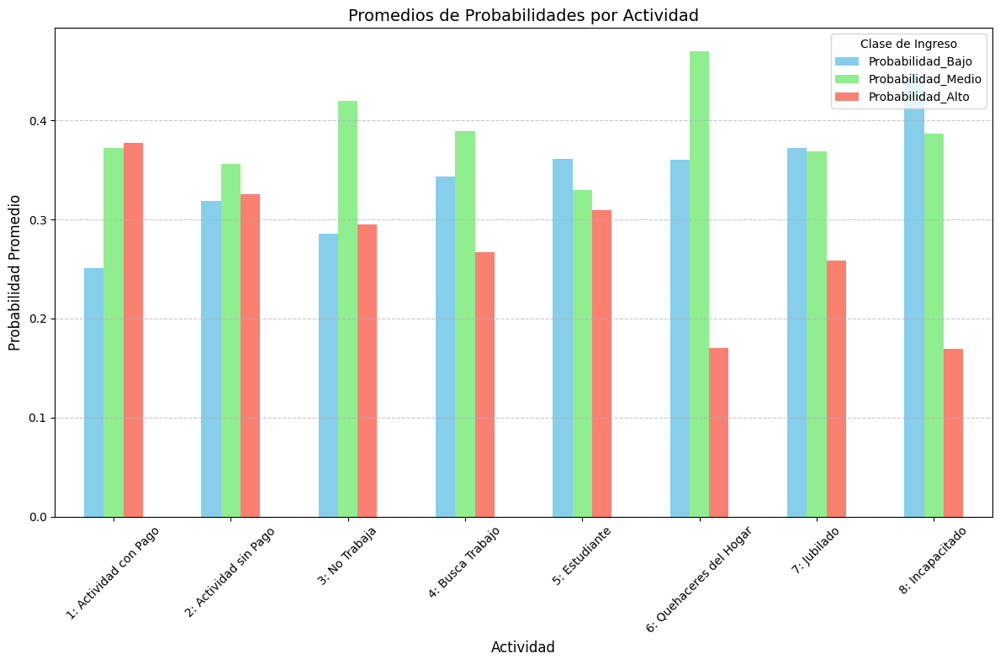

In [ ]:
promedios_actividad.plot(
    kind='bar',
    figsize=(12, 8),
    rot=45,
    color=['skyblue', 'lightgreen', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Actividad", fontsize=14)
plt.ylabel("Probabilidad Promedio", fontsize=12)
plt.xlabel("Actividad", fontsize=12)
plt.xticks(fontsize=10)
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Asegurar que las etiquetas no se corten
plt.tight_layout()

# Mostrar el gráfico
plt.show()

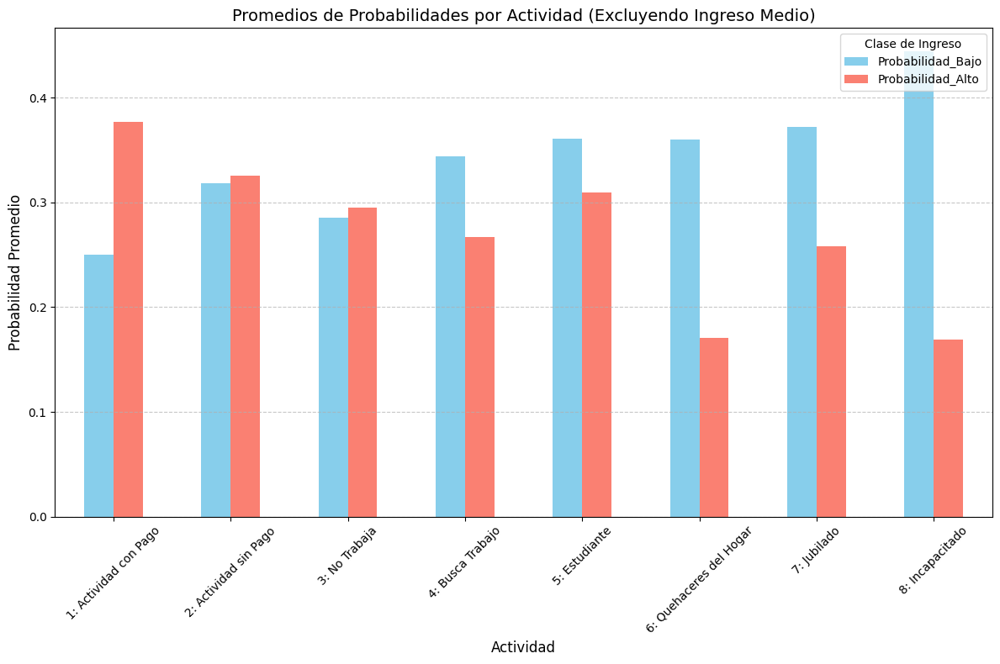

In [ ]:
# Crear un gráfico de barras excluyendo "Probabilidad_Medio"
promedios_sin_medio_actividad = promedios_actividad.drop(columns=['Probabilidad_Medio'])
promedios_sin_medio_actividad.plot(
    kind='bar',
    figsize=(12, 8),
    rot=45,
    color=['skyblue', 'salmon']
)

# Configurar etiquetas y título
plt.title("Promedios de Probabilidades por Actividad (Excluyendo Ingreso Medio)", fontsize=14)
plt.ylabel("Probabilidad Promedio", fontsize=12)
plt.xlabel("Actividad", fontsize=12)
plt.xticks(fontsize=10)
plt.legend(title="Clase de Ingreso", loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Asegurar que las etiquetas no se corten
plt.tight_layout()

# Mostrar el gráfico
plt.show()